# BY: Mohamed Mahmoud  


In [1]:
# by sokrat
import pandas as pd
import numpy as np
from numpy.random import Generator as gen
from numpy.random import PCG64 as pcg
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style('darkgrid') 

C:\Users\anaes\anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
service_time_servace=pd.DataFrame({'service_time':range(1,7),'probability':[0.10,0.20,0.30,0.25,0.10,0.05]})
service_time_servace['cumulative']=0
service_time_servace['start_randome']=0
service_time_servace['end_randome']=0

service_time_servace

,service_time,probability,cumulative,start_randome,end_randome
0,1,0.10,0,0,0
1,2,0.20,0,0,0
2,3,0.30,0,0,0
3,4,0.25,0,0,0
4,5,0.10,0,0,0
5,6,0.05,0,0,0


In [3]:
temp=0
st_rand=1
for i in range(len(service_time_servace)):
    service_time_servace.iloc[i,3]=st_rand+temp*100
    temp+=service_time_servace.iloc[i,1]
    service_time_servace.iloc[i,2]=temp
    service_time_servace.iloc[i,4]=service_time_servace.iloc[i,2]*100
service_time_servace.iloc[:, 3] = service_time_servace.iloc[:, 3].astype(int)
service_time_servace.iloc[:, 4] = service_time_servace.iloc[:, 4].astype(int)

service_time_servace

,service_time,probability,cumulative,start_randome,end_randome
0,1,0.10,0.10,1,10
1,2,0.20,0.30,11,30
2,3,0.30,0.60,31,60
3,4,0.25,0.85,61,85
4,5,0.10,0.95,86,95
5,6,0.05,1.00,96,100


In [4]:

array_RG = gen(pcg())


In [5]:
w_c=[] # waiting_time_customer_in_the_que 
N_C=[] #total_number_of_customer
avg_waiting_time=[]
avg_service_time=[]
total_service_time=[]
total_time_between_arrivals=[]
avg_time_between_arrivals=[]
prob_wait=[]
prob_idle=[]
avg_waiting_time_of_who_wait=[]
avg_customer_spend_systeam=[]
import pandas as pd
see=[11,203,5,45,18,6,2,4]
for j in see:    
    array_RG = gen(pcg(seed=j))
    for q in range(1000):
        interarrival_time = array_RG.integers(10,size=(1,15))
        interarrival_time=array_RG.integers(10,size=(1,15)).tolist()
        interarrival_time=interarrival_time[0]
        server_time = array_RG.integers(10,size=(1,15)).tolist()
        server_time=server_time[0]
        interarrival_time[0]=0

        # Create a DataFrame
        simulation_Table = pd.DataFrame({'interarrival_time': interarrival_time, 'server_time': server_time})
        simulation_Table['time_service_begins'] = 0
        simulation_Table['time_service_end'] = 0
        simulation_Table['waiting_time'] = 0
        simulation_Table['time_customer_in_systeam'] = 0
        simulation_Table['ideal_time'] = 0
        


        # Calculate arrival time and insert as a new column
        arrival_time = [sum(interarrival_time[:i+1]) for i in range(len(interarrival_time))]
        simulation_Table.insert(1, 'arrival_time', arrival_time)

        # Simulation loop
        count=0 # that to count not zero for probability
        total_run_time_simulation=0
        total_idle_time=0
        total_time_customer_in_systeam=0
        for i in range(len(simulation_Table)):
            if i == 0:
                # For the first customer
                simulation_Table.loc[i, 'time_service_end'] = simulation_Table.loc[i, 'server_time']
                simulation_Table.loc[i,'waiting_time'] = 0
                simulation_Table.loc[i,'time_customer_in_systeam'] = 0
                simulation_Table.loc[i,'ideal_time'] = 0
            else:
                # For subsequent customers
                previous_service_end = simulation_Table.loc[i - 1, 'time_service_end']
                arrival_time_current = simulation_Table.loc[i, 'arrival_time']

                if previous_service_end <= arrival_time_current:
                    # Customer arrives after or exactly when the previous customers service ends
                    simulation_Table.loc[i, 'time_service_begins'] = arrival_time_current
                    simulation_Table.loc[i, 'time_service_end'] = arrival_time_current + simulation_Table.loc[i, 'server_time']
                else:
                    # Customer arrives before the previous customers service ends
                    simulation_Table.loc[i, 'time_service_begins'] = previous_service_end
                    simulation_Table.loc[i, 'time_service_end'] = previous_service_end + simulation_Table.loc[i, 'server_time']
                    

            # Calculate waiting time
            simulation_Table.loc[i, 'waiting_time'] = simulation_Table.loc[i, 'time_service_begins'] - simulation_Table.loc[i, 'arrival_time']
            if(simulation_Table.loc[i, 'waiting_time']!=0):
                 count+=1
            # Calculate time the customer is in the system
            simulation_Table.loc[i, 'time_customer_in_systeam'] = simulation_Table.loc[i, 'time_service_end'] - simulation_Table.loc[i, 'arrival_time']

            # Calculate ideal time (idle time) for the server
            if i > 0:
                previous_ideal_time = simulation_Table.loc[i, 'arrival_time'] - simulation_Table.loc[i - 1, 'time_service_end']
                simulation_Table.loc[i, 'ideal_time'] = max(0, previous_ideal_time)
        # probability of ideal time

        total_run_time_simulation=simulation_Table.loc[len(simulation_Table)-1, 'time_service_end']
        total_idle_time=sum(simulation_Table['ideal_time'])
        prob_idle.append(total_idle_time/total_run_time_simulation)
        
        # average_service_time 
        total_service_time.append(sum(simulation_Table['server_time']))
        # average_time_between_arrivals
        total_time_between_arrivals.append(simulation_Table.loc[len(simulation_Table)-1, 'arrival_time'])

        w_c.append(sum(simulation_Table[ 'waiting_time']))
        N_C.append(len(simulation_Table))
        prob_wait.append(count/N_C[q])
        # avg_waiting_time_of_who_wait
        try:
            
            avg_waiting_time_of_who_wait.append(w_c[q]/count)
        except ZeroDivisionError :
            avg_waiting_time_of_who_wait.append(0)
        #avg_customer_spend_systeam
        total_time_customer_in_systeam=sum(simulation_Table[ 'time_customer_in_systeam'])
        avg_customer_spend_systeam.append(total_time_customer_in_systeam/N_C[q])
        print(simulation_Table)
    
    
            




    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   7             7            7                    7   
2                   9            16            2                   16   
3                   9            25            6                   25   
4                   6            31            4                   31   
5                   8            39            5                   39   
6                   3            42            9                   44   
7                   1            43            8                   53   
8                   5            48            8                   61   
9                   4            52            5                   69   
10                  6            58            9                   74   
11                  9            67            9                   83   
12                  2            69            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   2             2            3                    9   
2                   8            10            6                   12   
3                   9            19            1                   19   
4                   1            20            7                   20   
5                   8            28            3                   28   
6                   9            37            6                   37   
7                   6            43            0                   43   
8                   2            45            1                   45   
9                   6            51            2                   51   
10                  3            54            1                   54   
11                  3            57            9                   57   
12                  5            62            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   0             0            8                    2   
2                   1             1            7                   10   
3                   4             5            2                   17   
4                   2             7            2                   19   
5                   0             7            8                   21   
6                   5            12            2                   29   
7                   0            12            1                   31   
8                   7            19            4                   32   
9                   1            20            5                   36   
10                  4            24            0                   41   
11                  3            27            9                   41   
12                  7            34            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   2             2            1                    2   
2                   7             9            1                    9   
3                   0             9            2                   10   
4                   7            16            0                   16   
5                   6            22            6                   22   
6                   5            27            4                   28   
7                   6            33            7                   33   
8                   6            39            3                   40   
9                   0            39            7                   43   
10                  6            45            8                   50   
11                  5            50            3                   58   
12                  0            50            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   7             7            9                    7   
2                   0             7            8                   16   
3                   2             9            3                   24   
4                   8            17            9                   27   
5                   4            21            5                   36   
6                   4            25            2                   41   
7                   0            25            5                   43   
8                   1            26            8                   48   
9                   7            33            2                   56   
10                  0            33            1                   58   
11                  0            33            8                   59   
12                  4            37            7   

14                92             4                        13           0  
    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   8             8            2                    8   
2                   8            16            8                   16   
3                   0            16            9                   24   
4                   9            25            1                   33   
5                   9            34            9                   34   
6                   5            39            4                   43   
7                   0            39            1                   47   
8                   7            46            6                   48   
9                   7            53            1                   54   
10                  0            53            4                   55   
11                  2            55            3 

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   0             0            0                    3   
2                   9             9            4                    9   
3                   4            13            4                   13   
4                   6            19            1                   19   
5                   5            24            8                   24   
6                   6            30            2                   32   
7                   6            36            4                   36   
8                   9            45            8                   45   
9                   5            50            9                   53   
10                  8            58            4                   62   
11                  3            61            2                   66   
12                  9            70            1   

14                73             3                         8           0  
    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   3             3            3                    3   
2                   2             5            4                    6   
3                   6            11            2                   11   
4                   5            16            9                   16   
5                   6            22            6                   25   
6                   8            30            4                   31   
7                   2            32            8                   35   
8                   2            34            2                   43   
9                   7            41            4                   45   
10                  6            47            6                   49   
11                  7            54            1 

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   7             7            5                    9   
2                   1             8            6                   14   
3                   6            14            3                   20   
4                   7            21            7                   23   
5                   9            30            2                   30   
6                   5            35            9                   35   
7                   0            35            1                   44   
8                   9            44            5                   45   
9                   4            48            1                   50   
10                  9            57            9                   57   
11                  6            63            7                   66   
12                  3            66            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   8             8            5                    8   
2                   7            15            4                   15   
3                   4            19            9                   19   
4                   1            20            9                   28   
5                   8            28            3                   37   
6                   7            35            7                   40   
7                   9            44            1                   47   
8                   1            45            8                   48   
9                   5            50            1                   56   
10                  0            50            6                   57   
11                  8            58            8                   63   
12                  7            65            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            7                    9   
2                   2            11            8                   16   
3                   4            15            7                   24   
4                   0            15            5                   31   
5                   2            17            7                   36   
6                   5            22            4                   43   
7                   9            31            9                   47   
8                   3            34            0                   56   
9                   1            35            1                   56   
10                  0            35            0                   57   
11                  8            43            8                   57   
12                  7            50            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   7             7            4                    8   
2                   3            10            7                   12   
3                   4            14            2                   19   
4                   7            21            2                   21   
5                   6            27            8                   27   
6                   1            28            3                   35   
7                   1            29            8                   38   
8                   1            30            1                   46   
9                   5            35            7                   47   
10                  9            44            9                   54   
11                  8            52            6                   63   
12                  4            56            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   0             0            9                    7   
2                   0             0            4                   16   
3                   5             5            8                   20   
4                   7            12            7                   28   
5                   5            17            2                   35   
6                   9            26            5                   37   
7                   0            26            0                   42   
8                   3            29            4                   42   
9                   6            35            2                   46   
10                  8            43            5                   48   
11                  0            43            5                   53   
12                  5            48            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   3             3            9                    3   
2                   1             4            3                   12   
3                   4             8            0                   15   
4                   2            10            7                   15   
5                   4            14            2                   22   
6                   7            21            0                   24   
7                   5            26            5                   26   
8                   3            29            9                   31   
9                   2            31            3                   40   
10                  6            37            1                   43   
11                  6            43            4                   44   
12                  0            43            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   8             8            8                    8   
2                   1             9            0                   16   
3                   3            12            7                   16   
4                   8            20            4                   23   
5                   6            26            4                   27   
6                   0            26            4                   31   
7                   7            33            1                   35   
8                   3            36            6                   36   
9                   8            44            2                   44   
10                  9            53            5                   53   
11                  4            57            4                   58   
12                  1            58            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   2             2            0                    8   
2                   3             5            6                    8   
3                   4             9            1                   14   
4                   2            11            5                   15   
5                   4            15            0                   20   
6                   1            16            1                   20   
7                   0            16            8                   21   
8                   1            17            6                   29   
9                   5            22            7                   35   
10                  4            26            9                   42   
11                  4            30            6                   51   
12                  3            33            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   8             8            9                    9   
2                   6            14            8                   18   
3                   1            15            5                   26   
4                   0            15            3                   31   
5                   8            23            8                   34   
6                   2            25            4                   42   
7                   2            27            9                   46   
8                   3            30            3                   55   
9                   4            34            1                   58   
10                  6            40            3                   59   
11                  7            47            3                   62   
12                  0            47            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   7             7            0                    7   
2                   5            12            1                   12   
3                   6            18            2                   18   
4                   6            24            9                   24   
5                   7            31            2                   33   
6                   0            31            4                   35   
7                   7            38            0                   39   
8                   2            40            5                   40   
9                   0            40            7                   45   
10                  9            49            6                   52   
11                  7            56            2                   58   
12                  3            59            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   2             2            8                    2   
2                   4             6            1                   10   
3                   9            15            7                   15   
4                   4            19            1                   22   
5                   6            25            3                   25   
6                   2            27            7                   28   
7                   6            33            5                   35   
8                   6            39            2                   40   
9                   0            39            3                   42   
10                  4            43            8                   45   
11                  2            45            8                   53   
12                  5            50            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   2             2            7                    7   
2                   5             7            1                   14   
3                   5            12            1                   15   
4                   4            16            7                   16   
5                   2            18            1                   23   
6                   7            25            7                   25   
7                   6            31            2                   32   
8                   7            38            8                   38   
9                   6            44            3                   46   
10                  3            47            8                   49   
11                  0            47            1                   57   
12                  9            56            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   0             0            4                    5   
2                   6             6            3                    9   
3                   1             7            2                   12   
4                   7            14            7                   14   
5                   5            19            3                   21   
6                   4            23            8                   24   
7                   2            25            7                   32   
8                   4            29            9                   39   
9                   5            34            4                   48   
10                  9            43            0                   52   
11                  9            52            7                   52   
12                  4            56            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   1             1            0                    4   
2                   8             9            9                    9   
3                   2            11            9                   18   
4                   5            16            8                   27   
5                   6            22            1                   35   
6                   2            24            7                   36   
7                   1            25            9                   43   
8                   4            29            6                   52   
9                   6            35            7                   58   
10                  7            42            1                   65   
11                  7            49            2                   66   
12                  6            55            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   8             8            6                    8   
2                   0             8            3                   14   
3                   8            16            3                   17   
4                   6            22            5                   22   
5                   7            29            1                   29   
6                   4            33            5                   33   
7                   1            34            1                   38   
8                   6            40            1                   40   
9                   4            44            2                   44   
10                  9            53            9                   53   
11                  9            62            9                   62   
12                  7            69            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   7             7            3                    8   
2                   6            13            2                   13   
3                   1            14            7                   15   
4                   7            21            7                   22   
5                   2            23            8                   29   
6                   1            24            7                   37   
7                   1            25            5                   44   
8                   5            30            3                   49   
9                   7            37            0                   52   
10                  6            43            3                   52   
11                  9            52            7                   55   
12                  3            55            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   6             6            8                    6   
2                   3             9            2                   14   
3                   3            12            3                   16   
4                   7            19            7                   19   
5                   3            22            7                   26   
6                   8            30            9                   33   
7                   2            32            0                   42   
8                   9            41            3                   42   
9                   0            41            3                   45   
10                  6            47            3                   48   
11                  8            55            7                   55   
12                  1            56            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   7             7            3                    9   
2                   6            13            9                   13   
3                   8            21            4                   22   
4                   3            24            0                   26   
5                   6            30            6                   30   
6                   8            38            4                   38   
7                   5            43            1                   43   
8                   9            52            5                   52   
9                   9            61            8                   61   
10                  1            62            1                   69   
11                  0            62            3                   70   
12                  7            69            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   3             3            6                    3   
2                   6             9            4                    9   
3                   6            15            4                   15   
4                   7            22            7                   22   
5                   1            23            5                   29   
6                   0            23            7                   34   
7                   8            31            0                   41   
8                   3            34            6                   41   
9                   9            43            1                   47   
10                  7            50            6                   50   
11                  9            59            4                   59   
12                  2            61            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   3             3            1                    3   
2                   6             9            0                    9   
3                   1            10            8                   10   
4                   7            17            3                   18   
5                   2            19            4                   21   
6                   2            21            8                   25   
7                   8            29            2                   33   
8                   6            35            2                   35   
9                   6            41            3                   41   
10                  9            50            2                   50   
11                  6            56            9                   56   
12                  9            65            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   0             0            2                    0   
2                   5             5            9                    5   
3                   1             6            8                   14   
4                   3             9            6                   22   
5                   8            17            9                   28   
6                   0            17            8                   37   
7                   2            19            3                   45   
8                   0            19            0                   48   
9                   0            19            1                   48   
10                  7            26            6                   49   
11                  3            29            4                   55   
12                  8            37            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   1             1            8                    7   
2                   6             7            2                   15   
3                   7            14            9                   17   
4                   2            16            7                   26   
5                   1            17            1                   33   
6                   4            21            7                   34   
7                   3            24            6                   41   
8                   5            29            3                   47   
9                   0            29            7                   50   
10                  1            30            4                   57   
11                  5            35            1                   61   
12                  7            42            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   7             7            9                    9   
2                   0             7            8                   18   
3                   9            16            1                   26   
4                   6            22            3                   27   
5                   5            27            7                   30   
6                   6            33            7                   37   
7                   2            35            8                   44   
8                   7            42            3                   52   
9                   2            44            5                   55   
10                  3            47            3                   60   
11                  8            55            7                   63   
12                  3            58            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            9                    6   
2                   0             6            2                   15   
3                   8            14            6                   17   
4                   7            21            2                   23   
5                   5            26            8                   26   
6                   1            27            3                   34   
7                   4            31            2                   37   
8                   6            37            7                   39   
9                   1            38            8                   46   
10                  3            41            7                   54   
11                  6            47            7                   61   
12                  2            49            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            8                    5   
2                   3             5            0                   13   
3                   1             6            2                   13   
4                   2             8            5                   15   
5                   0             8            8                   20   
6                   2            10            6                   28   
7                   0            10            7                   34   
8                   1            11            3                   41   
9                   2            13            7                   44   
10                  9            22            1                   51   
11                  2            24            6                   52   
12                  9            33            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            6                    4   
2                   6            10            1                   10   
3                   1            11            9                   11   
4                   7            18            4                   20   
5                   3            21            9                   24   
6                   8            29            4                   33   
7                   2            31            9                   37   
8                   8            39            6                   46   
9                   0            39            7                   52   
10                  0            39            9                   59   
11                  0            39            5                   68   
12                  1            40            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   1             1            4                    2   
2                   1             2            9                    6   
3                   1             3            0                   15   
4                   5             8            6                   15   
5                   6            14            0                   21   
6                   7            21            5                   21   
7                   8            29            1                   29   
8                   6            35            7                   35   
9                   4            39            2                   42   
10                  2            41            5                   44   
11                  3            44            8                   49   
12                  7            51            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   7             7            7                    9   
2                   2             9            8                   16   
3                   0             9            7                   24   
4                   2            11            9                   31   
5                   8            19            5                   40   
6                   6            25            1                   45   
7                   8            33            8                   46   
8                   9            42            5                   54   
9                   2            44            2                   59   
10                  9            53            8                   61   
11                  1            54            8                   69   
12                  2            56            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   0             0            3                    7   
2                   1             1            7                   10   
3                   7             8            1                   17   
4                   0             8            0                   18   
5                   1             9            1                   18   
6                   6            15            5                   19   
7                   4            19            7                   24   
8                   6            25            4                   31   
9                   2            27            1                   35   
10                  8            35            3                   36   
11                  1            36            3                   39   
12                  0            36            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   6             6            7                    6   
2                   1             7            4                   13   
3                   5            12            5                   17   
4                   3            15            8                   22   
5                   3            18            4                   30   
6                   2            20            6                   34   
7                   1            21            9                   40   
8                   6            27            9                   49   
9                   5            32            8                   58   
10                  0            32            5                   66   
11                  2            34            6                   71   
12                  3            37            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   9             9            2                    9   
2                   9            18            7                   18   
3                   7            25            5                   25   
4                   0            25            5                   30   
5                   0            25            9                   35   
6                   4            29            2                   44   
7                   6            35            6                   46   
8                   5            40            4                   52   
9                   0            40            2                   56   
10                  8            48            6                   58   
11                  9            57            8                   64   
12                  7            64            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            6                    9   
2                   1            10            8                   15   
3                   3            13            4                   23   
4                   8            21            3                   27   
5                   7            28            7                   30   
6                   7            35            9                   37   
7                   2            37            2                   46   
8                   5            42            9                   48   
9                   7            49            6                   57   
10                  9            58            1                   63   
11                  0            58            4                   64   
12                  1            59            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            7                    1   
2                   6             7            5                    8   
3                   1             8            8                   13   
4                   2            10            1                   21   
5                   3            13            3                   22   
6                   2            15            7                   25   
7                   5            20            6                   32   
8                   9            29            9                   38   
9                   5            34            7                   47   
10                  3            37            4                   54   
11                  4            41            1                   58   
12                  6            47            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            0                    5   
2                   0             2            4                    5   
3                   8            10            5                   10   
4                   9            19            1                   19   
5                   1            20            6                   20   
6                   9            29            1                   29   
7                   0            29            8                   30   
8                   8            37            1                   38   
9                   6            43            0                   43   
10                  5            48            4                   48   
11                  3            51            2                   52   
12                  9            60            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   0             0            4                    0   
2                   8             8            6                    8   
3                   8            16            6                   16   
4                   8            24            3                   24   
5                   3            27            1                   27   
6                   2            29            2                   29   
7                   1            30            6                   31   
8                   3            33            3                   37   
9                   7            40            6                   40   
10                  8            48            3                   48   
11                  3            51            6                   51   
12                  5            56            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   3             3            8                    3   
2                   6             9            6                   11   
3                   9            18            3                   18   
4                   4            22            8                   22   
5                   1            23            2                   30   
6                   5            28            7                   32   
7                   2            30            2                   39   
8                   0            30            3                   41   
9                   6            36            1                   44   
10                  6            42            2                   45   
11                  0            42            9                   47   
12                  4            46            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   6             6            7                    8   
2                   6            12            4                   15   
3                   9            21            4                   21   
4                   2            23            3                   25   
5                   9            32            0                   32   
6                   3            35            2                   35   
7                   9            44            6                   44   
8                   6            50            1                   50   
9                   0            50            7                   51   
10                  6            56            9                   58   
11                  4            60            4                   67   
12                  0            60            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   7             7            9                    8   
2                   0             7            7                   17   
3                   5            12            1                   24   
4                   8            20            9                   25   
5                   8            28            5                   34   
6                   0            28            5                   39   
7                   7            35            6                   44   
8                   6            41            8                   50   
9                   4            45            6                   58   
10                  4            49            3                   64   
11                  7            56            6                   67   
12                  9            65            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            4                    5   
2                   0             2            2                    9   
3                   6             8            2                   11   
4                   2            10            4                   13   
5                   0            10            4                   17   
6                   0            10            3                   21   
7                   5            15            5                   24   
8                   8            23            3                   29   
9                   0            23            8                   32   
10                  3            26            1                   40   
11                  8            34            4                   41   
12                  8            42            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   9             9            9                    9   
2                   8            17            7                   18   
3                   2            19            7                   25   
4                   6            25            6                   32   
5                   4            29            8                   38   
6                   6            35            8                   46   
7                   8            43            7                   54   
8                   8            51            4                   61   
9                   5            56            9                   65   
10                  0            56            7                   74   
11                  5            61            0                   81   
12                  4            65            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   9             9            9                    9   
2                   8            17            1                   18   
3                   7            24            3                   24   
4                   2            26            5                   27   
5                   4            30            4                   32   
6                   8            38            0                   38   
7                   4            42            0                   42   
8                   8            50            1                   50   
9                   5            55            7                   55   
10                  1            56            9                   62   
11                  9            65            3                   71   
12                  2            67            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            1                    4   
2                   9            13            6                   13   
3                   8            21            1                   21   
4                   7            28            3                   28   
5                   1            29            9                   31   
6                   4            33            3                   40   
7                   9            42            4                   43   
8                   7            49            2                   49   
9                   3            52            4                   52   
10                  6            58            2                   58   
11                  6            64            1                   64   
12                  9            73            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   3             3            3                    6   
2                   7            10            2                   10   
3                   5            15            2                   15   
4                   2            17            7                   17   
5                   4            21            0                   24   
6                   8            29            2                   29   
7                   1            30            3                   31   
8                   8            38            6                   38   
9                   9            47            2                   47   
10                  1            48            4                   49   
11                  3            51            4                   53   
12                  6            57            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   6             6            0                    9   
2                   5            11            1                   11   
3                   4            15            1                   15   
4                   3            18            7                   18   
5                   2            20            3                   25   
6                   6            26            7                   28   
7                   1            27            5                   35   
8                   6            33            0                   40   
9                   8            41            7                   41   
10                  0            41            6                   48   
11                  8            49            9                   54   
12                  7            56            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   5             5            3                    5   
2                   7            12            0                   12   
3                   0            12            1                   12   
4                   1            13            8                   13   
5                   7            20            6                   21   
6                   1            21            4                   27   
7                   9            30            3                   31   
8                   0            30            0                   34   
9                   6            36            3                   36   
10                  2            38            7                   39   
11                  9            47            5                   47   
12                  2            49            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            3                    8   
2                   2             7            9                   11   
3                   7            14            8                   20   
4                   8            22            9                   28   
5                   6            28            1                   37   
6                   5            33            6                   38   
7                   4            37            2                   44   
8                   7            44            5                   46   
9                   2            46            2                   51   
10                  1            47            2                   53   
11                  0            47            2                   55   
12                  1            48            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   0             0            5                    5   
2                   3             3            1                   10   
3                   0             3            2                   11   
4                   0             3            5                   13   
5                   2             5            9                   18   
6                   0             5            0                   27   
7                   6            11            2                   27   
8                   0            11            1                   29   
9                   2            13            4                   30   
10                  0            13            2                   34   
11                  1            14            4                   36   
12                  7            21            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            0                    4   
2                   7            11            9                   11   
3                   1            12            2                   20   
4                   8            20            8                   22   
5                   7            27            9                   30   
6                   8            35            0                   39   
7                   4            39            7                   39   
8                   3            42            2                   46   
9                   9            51            7                   51   
10                  4            55            2                   58   
11                  8            63            2                   63   
12                  1            64            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            5                    5   
2                   3             5            1                   10   
3                   4             9            9                   11   
4                   1            10            4                   20   
5                   2            12            6                   24   
6                   9            21            4                   30   
7                   1            22            3                   34   
8                   5            27            0                   37   
9                   6            33            3                   37   
10                  3            36            0                   40   
11                  3            39            8                   40   
12                  9            48            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   6             6            7                    7   
2                   9            15            4                   15   
3                   9            24            2                   24   
4                   4            28            1                   28   
5                   4            32            7                   32   
6                   5            37            8                   39   
7                   6            43            9                   47   
8                   9            52            1                   56   
9                   1            53            8                   57   
10                  5            58            3                   65   
11                  8            66            9                   68   
12                  3            69            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   0             0            1                    5   
2                   7             7            4                    7   
3                   9            16            2                   16   
4                   2            18            8                   18   
5                   2            20            0                   26   
6                   5            25            8                   26   
7                   0            25            3                   34   
8                   7            32            0                   37   
9                   6            38            1                   38   
10                  1            39            4                   39   
11                  8            47            4                   47   
12                  4            51            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   5             5            5                    9   
2                   7            12            6                   14   
3                   9            21            0                   21   
4                   2            23            2                   23   
5                   7            30            2                   30   
6                   0            30            0                   32   
7                   7            37            7                   37   
8                   4            41            8                   44   
9                   2            43            5                   52   
10                  4            47            3                   57   
11                  3            50            3                   60   
12                  9            59            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   8             8            9                    8   
2                   4            12            1                   17   
3                   8            20            7                   20   
4                   6            26            7                   27   
5                   1            27            8                   34   
6                   4            31            6                   42   
7                   4            35            1                   48   
8                   2            37            0                   49   
9                   5            42            4                   49   
10                  8            50            5                   53   
11                  4            54            9                   58   
12                  1            55            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   9             9            3                    9   
2                   8            17            7                   17   
3                   6            23            5                   24   
4                   4            27            8                   29   
5                   5            32            9                   37   
6                   5            37            1                   46   
7                   7            44            7                   47   
8                   9            53            0                   54   
9                   9            62            2                   62   
10                  9            71            6                   71   
11                  7            78            5                   78   
12                  6            84            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   1             1            5                    8   
2                   7             8            7                   13   
3                   4            12            6                   20   
4                   5            17            5                   26   
5                   3            20            9                   31   
6                   6            26            1                   40   
7                   9            35            0                   41   
8                   1            36            2                   41   
9                   0            36            4                   43   
10                  6            42            7                   47   
11                  8            50            3                   54   
12                  7            57            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   6             6            9                    6   
2                   1             7            7                   15   
3                   7            14            2                   22   
4                   2            16            3                   24   
5                   3            19            4                   27   
6                   0            19            0                   31   
7                   0            19            1                   31   
8                   2            21            1                   32   
9                   5            26            6                   33   
10                  6            32            7                   39   
11                  6            38            4                   46   
12                  9            47            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   2             2            1                    2   
2                   8            10            5                   10   
3                   0            10            1                   15   
4                   6            16            1                   16   
5                   5            21            3                   21   
6                   3            24            0                   24   
7                   3            27            9                   27   
8                   8            35            8                   36   
9                   9            44            1                   44   
10                  1            45            7                   45   
11                  2            47            2                   52   
12                  9            56            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   1             1            1                    5   
2                   8             9            2                    9   
3                   3            12            0                   12   
4                   6            18            4                   18   
5                   9            27            3                   27   
6                   8            35            9                   35   
7                   2            37            1                   44   
8                   5            42            1                   45   
9                   0            42            6                   46   
10                  8            50            1                   52   
11                  4            54            3                   54   
12                  8            62            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            6                    4   
2                   3             5            1                   10   
3                   0             5            3                   11   
4                   2             7            5                   14   
5                   2             9            2                   19   
6                   9            18            1                   21   
7                   4            22            2                   22   
8                   0            22            5                   24   
9                   6            28            2                   29   
10                  5            33            8                   33   
11                  2            35            7                   41   
12                  3            38            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   1             1            8                    7   
2                   7             8            8                   15   
3                   3            11            0                   23   
4                   9            20            3                   23   
5                   3            23            4                   26   
6                   9            32            4                   32   
7                   5            37            6                   37   
8                   3            40            4                   43   
9                   9            49            3                   49   
10                  4            53            2                   53   
11                  2            55            4                   55   
12                  2            57            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   9             9            5                    9   
2                   6            15            3                   15   
3                   4            19            0                   19   
4                   4            23            9                   23   
5                   3            26            8                   32   
6                   9            35            8                   40   
7                   5            40            4                   48   
8                   1            41            3                   52   
9                   9            50            6                   55   
10                  4            54            2                   61   
11                  9            63            0                   63   
12                  8            71            7   

14                87            15                        24           0  
    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   0             0            2                    9   
2                   5             5            7                   11   
3                   3             8            4                   18   
4                   1             9            7                   22   
5                   6            15            1                   29   
6                   4            19            1                   30   
7                   1            20            0                   31   
8                   6            26            2                   31   
9                   3            29            3                   33   
10                  3            32            0                   36   
11                  8            40            5 

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            2                    6   
2                   7            13            7                   13   
3                   9            22            3                   22   
4                   9            31            8                   31   
5                   1            32            3                   39   
6                   6            38            3                   42   
7                   4            42            3                   45   
8                   5            47            9                   48   
9                   6            53            4                   57   
10                  3            56            8                   61   
11                  3            59            1                   69   
12                  8            67            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   7             7            4                    7   
2                   0             7            5                   11   
3                   5            12            9                   16   
4                   1            13            9                   25   
5                   6            19            4                   34   
6                   8            27            5                   38   
7                   5            32            5                   43   
8                   0            32            6                   48   
9                   9            41            3                   54   
10                  8            49            9                   57   
11                  0            49            2                   66   
12                  8            57            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   9             9            2                    9   
2                   8            17            4                   17   
3                   0            17            1                   21   
4                   6            23            2                   23   
5                   8            31            6                   31   
6                   3            34            1                   37   
7                   3            37            2                   38   
8                   2            39            4                   40   
9                   8            47            9                   47   
10                  2            49            8                   56   
11                  7            56            8                   64   
12                  8            64            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            6                    9   
2                   2            11            7                   15   
3                   6            17            2                   22   
4                   8            25            8                   25   
5                   8            33            5                   33   
6                   8            41            7                   41   
7                   3            44            7                   48   
8                   9            53            0                   55   
9                   2            55            6                   55   
10                  9            64            5                   64   
11                  9            73            2                   73   
12                  0            73            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   7             7            3                    7   
2                   8            15            9                   15   
3                   0            15            3                   24   
4                   3            18            2                   27   
5                   1            19            6                   29   
6                   2            21            4                   35   
7                   5            26            9                   39   
8                   1            27            3                   48   
9                   3            30            6                   51   
10                  2            32            5                   57   
11                  7            39            3                   62   
12                  5            44            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   4             4            1                    4   
2                   0             4            3                    5   
3                   5             9            4                    9   
4                   9            18            4                   18   
5                   3            21            6                   22   
6                   0            21            2                   28   
7                   6            27            0                   30   
8                   1            28            9                   30   
9                   4            32            5                   39   
10                  3            35            2                   44   
11                  8            43            6                   46   
12                  2            45            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   8             8            8                    8   
2                   6            14            2                   16   
3                   8            22            1                   22   
4                   7            29            5                   29   
5                   7            36            7                   36   
6                   4            40            0                   43   
7                   2            42            4                   43   
8                   3            45            5                   47   
9                   3            48            9                   52   
10                  6            54            8                   61   
11                  8            62            9                   69   
12                  4            66            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   3             3            1                    7   
2                   1             4            4                    8   
3                   4             8            9                   12   
4                   2            10            9                   21   
5                   8            18            0                   30   
6                   1            19            5                   30   
7                   1            20            0                   35   
8                   2            22            8                   35   
9                   5            27            2                   43   
10                  6            33            0                   45   
11                  1            34            9                   45   
12                  6            40            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            6                    4   
2                   8            12            3                   12   
3                   2            14            0                   15   
4                   7            21            1                   21   
5                   2            23            3                   23   
6                   0            23            0                   26   
7                   7            30            0                   30   
8                   4            34            0                   34   
9                   8            42            8                   42   
10                  7            49            7                   50   
11                  3            52            2                   57   
12                  4            56            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   3             3            8                    3   
2                   4             7            3                   11   
3                   5            12            6                   14   
4                   3            15            6                   20   
5                   8            23            4                   26   
6                   2            25            8                   30   
7                   0            25            6                   38   
8                   2            27            6                   44   
9                   5            32            6                   50   
10                  7            39            3                   56   
11                  7            46            5                   59   
12                  0            46            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   4             4            1                    5   
2                   1             5            5                    6   
3                   3             8            2                   11   
4                   7            15            6                   15   
5                   4            19            6                   21   
6                   6            25            0                   27   
7                   1            26            7                   27   
8                   4            30            8                   34   
9                   2            32            2                   42   
10                  5            37            6                   44   
11                  4            41            8                   50   
12                  5            46            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   3             3            9                    4   
2                   5             8            7                   13   
3                   8            16            3                   20   
4                   1            17            5                   23   
5                   4            21            4                   28   
6                   9            30            4                   32   
7                   0            30            7                   36   
8                   2            32            2                   43   
9                   8            40            2                   45   
10                  7            47            8                   47   
11                  6            53            0                   55   
12                  6            59            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   1             1            3                    1   
2                   9            10            4                   10   
3                   6            16            3                   16   
4                   7            23            6                   23   
5                   7            30            6                   30   
6                   4            34            5                   36   
7                   7            41            4                   41   
8                   9            50            8                   50   
9                   7            57            2                   58   
10                  4            61            2                   61   
11                  6            67            9                   67   
12                  6            73            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   4             4            7                    4   
2                   5             9            3                   11   
3                   4            13            5                   14   
4                   8            21            7                   21   
5                   9            30            2                   30   
6                   3            33            9                   33   
7                   4            37            4                   42   
8                   0            37            6                   46   
9                   1            38            4                   52   
10                  5            43            3                   56   
11                  7            50            8                   59   
12                  0            50            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   0             0            6                    6   
2                   7             7            5                   12   
3                   7            14            4                   17   
4                   7            21            3                   21   
5                   6            27            2                   27   
6                   1            28            4                   29   
7                   5            33            7                   33   
8                   6            39            3                   40   
9                   0            39            8                   43   
10                  8            47            4                   51   
11                  2            49            2                   55   
12                  3            52            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   3             3            2                    9   
2                   4             7            2                   11   
3                   6            13            3                   13   
4                   8            21            0                   21   
5                   7            28            5                   28   
6                   7            35            5                   35   
7                   0            35            3                   40   
8                   9            44            6                   44   
9                   7            51            6                   51   
10                  8            59            9                   59   
11                  2            61            9                   68   
12                  1            62            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            0                    8   
2                   0             5            9                    8   
3                   8            13            5                   17   
4                   7            20            4                   22   
5                   4            24            3                   26   
6                   8            32            2                   32   
7                   2            34            7                   34   
8                   2            36            6                   41   
9                   9            45            1                   47   
10                  9            54            3                   54   
11                  8            62            1                   62   
12                  7            69            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   3             3            7                    7   
2                   0             3            7                   14   
3                   0             3            7                   21   
4                   2             5            0                   28   
5                   6            11            8                   28   
6                   5            16            2                   36   
7                   9            25            5                   38   
8                   5            30            5                   43   
9                   9            39            8                   48   
10                  2            41            4                   56   
11                  2            43            5                   60   
12                  7            50            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   0             0            2                    5   
2                   6             6            5                    7   
3                   3             9            9                   12   
4                   4            13            4                   21   
5                   4            17            6                   25   
6                   4            21            2                   31   
7                   6            27            3                   33   
8                   0            27            0                   36   
9                   3            30            2                   36   
10                  0            30            4                   38   
11                  9            39            4                   42   
12                  0            39            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            4                    8   
2                   1             4            7                   12   
3                   6            10            4                   19   
4                   5            15            1                   23   
5                   9            24            5                   24   
6                   6            30            1                   30   
7                   6            36            3                   36   
8                   6            42            3                   42   
9                   9            51            1                   51   
10                  1            52            1                   52   
11                  5            57            7                   57   
12                  8            65            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            6                    8   
2                   1             6            4                   14   
3                   5            11            7                   18   
4                   5            16            4                   25   
5                   6            22            8                   29   
6                   8            30            4                   37   
7                   1            31            4                   41   
8                   5            36            2                   45   
9                   7            43            3                   47   
10                  4            47            2                   50   
11                  9            56            1                   56   
12                  9            65            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            5                    8   
2                   0             5            3                   13   
3                   9            14            0                   16   
4                   3            17            5                   17   
5                   8            25            2                   25   
6                   7            32            6                   32   
7                   2            34            2                   38   
8                   3            37            2                   40   
9                   2            39            8                   42   
10                  0            39            5                   50   
11                  0            39            9                   55   
12                  6            45            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   4             4            2                    7   
2                   8            12            6                   12   
3                   9            21            2                   21   
4                   6            27            5                   27   
5                   1            28            5                   32   
6                   7            35            1                   37   
7                   2            37            3                   38   
8                   7            44            3                   44   
9                   9            53            8                   53   
10                  8            61            2                   61   
11                  2            63            8                   63   
12                  3            66            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   3             3            9                    6   
2                   7            10            5                   15   
3                   7            17            9                   20   
4                   2            19            3                   29   
5                   8            27            6                   32   
6                   5            32            2                   38   
7                   7            39            6                   40   
8                   5            44            9                   46   
9                   4            48            5                   55   
10                  5            53            7                   60   
11                  9            62            0                   67   
12                  6            68            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   5             5            1                    5   
2                   2             7            0                    7   
3                   8            15            2                   15   
4                   8            23            2                   23   
5                   6            29            4                   29   
6                   8            37            8                   37   
7                   9            46            9                   46   
8                   5            51            3                   55   
9                   4            55            3                   58   
10                  3            58            7                   61   
11                  0            58            6                   68   
12                  7            65            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   3             3            5                    3   
2                   7            10            1                   10   
3                   5            15            4                   15   
4                   6            21            0                   21   
5                   4            25            1                   25   
6                   1            26            0                   26   
7                   6            32            8                   32   
8                   4            36            4                   40   
9                   5            41            0                   44   
10                  1            42            0                   44   
11                  5            47            7                   47   
12                  3            50            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   0             0            4                    4   
2                   0             0            6                    8   
3                   0             0            3                   14   
4                   7             7            3                   17   
5                   0             7            6                   20   
6                   3            10            8                   26   
7                   5            15            8                   34   
8                   8            23            6                   42   
9                   3            26            0                   48   
10                  1            27            7                   48   
11                  2            29            1                   55   
12                  2            31            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   4             4            3                    4   
2                   2             6            5                    7   
3                   8            14            2                   14   
4                   0            14            8                   16   
5                   4            18            9                   24   
6                   1            19            6                   33   
7                   5            24            0                   39   
8                   9            33            9                   39   
9                   3            36            5                   48   
10                  4            40            5                   53   
11                  4            44            9                   58   
12                  5            49            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   0             0            9                    2   
2                   4             4            1                   11   
3                   5             9            8                   12   
4                   4            13            9                   20   
5                   3            16            1                   29   
6                   3            19            4                   30   
7                   7            26            0                   34   
8                   6            32            5                   34   
9                   6            38            2                   39   
10                  6            44            6                   44   
11                  4            48            6                   50   
12                  9            57            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   7             7            0                    8   
2                   3            10            9                   10   
3                   7            17            5                   19   
4                   5            22            7                   24   
5                   2            24            3                   31   
6                   2            26            3                   34   
7                   8            34            8                   37   
8                   6            40            2                   45   
9                   6            46            8                   47   
10                  2            48            4                   55   
11                  4            52            7                   59   
12                  9            61            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            9                    9   
2                   1             2            2                   18   
3                   3             5            4                   20   
4                   0             5            5                   24   
5                   8            13            5                   29   
6                   4            17            1                   34   
7                   8            25            5                   35   
8                   0            25            3                   40   
9                   5            30            8                   43   
10                  1            31            0                   51   
11                  2            33            0                   51   
12                  5            38            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            2                    6   
2                   1             7            9                    8   
3                   6            13            3                   17   
4                   4            17            9                   20   
5                   4            21            0                   29   
6                   5            26            5                   29   
7                   8            34            2                   34   
8                   8            42            1                   42   
9                   0            42            0                   43   
10                  7            49            2                   49   
11                  1            50            0                   51   
12                  1            51            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   7             7            5                    7   
2                   3            10            4                   12   
3                   2            12            8                   16   
4                   1            13            9                   24   
5                   8            21            6                   33   
6                   1            22            2                   39   
7                   6            28            6                   41   
8                   2            30            7                   47   
9                   3            33            4                   54   
10                  3            36            3                   58   
11                  6            42            2                   61   
12                  2            44            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   7             7            3                    7   
2                   6            13            0                   13   
3                   4            17            9                   17   
4                   0            17            0                   26   
5                   8            25            8                   26   
6                   5            30            7                   34   
7                   6            36            5                   41   
8                   2            38            4                   46   
9                   6            44            2                   50   
10                  9            53            7                   53   
11                  8            61            5                   61   
12                  6            67            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   5             5            2                    5   
2                   9            14            6                   14   
3                   5            19            5                   20   
4                   4            23            8                   25   
5                   5            28            8                   33   
6                   9            37            0                   41   
7                   9            46            7                   46   
8                   7            53            9                   53   
9                   3            56            4                   62   
10                  0            56            0                   66   
11                  8            64            1                   66   
12                  0            64            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   7             7            7                    7   
2                   9            16            6                   16   
3                   1            17            7                   22   
4                   9            26            0                   29   
5                   2            28            0                   29   
6                   6            34            6                   34   
7                   1            35            6                   40   
8                   9            44            1                   46   
9                   3            47            1                   47   
10                  6            53            9                   53   
11                  1            54            3                   62   
12                  4            58            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   1             1            0                    1   
2                   2             3            6                    3   
3                   1             4            3                    9   
4                   9            13            3                   13   
5                   0            13            4                   16   
6                   5            18            4                   20   
7                   2            20            5                   24   
8                   4            24            4                   29   
9                   8            32            4                   33   
10                  8            40            3                   40   
11                  7            47            6                   47   
12                  7            54            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   5             5            8                    5   
2                   3             8            4                   13   
3                   1             9            0                   17   
4                   3            12            0                   17   
5                   3            15            1                   17   
6                   3            18            1                   18   
7                   1            19            5                   19   
8                   9            28            3                   28   
9                   0            28            5                   31   
10                  4            32            3                   36   
11                  5            37            1                   39   
12                  4            41            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   5             5            0                    5   
2                   8            13            9                   13   
3                   5            18            5                   22   
4                   6            24            7                   27   
5                   4            28            7                   34   
6                   5            33            9                   41   
7                   6            39            0                   50   
8                   8            47            2                   50   
9                   2            49            9                   52   
10                  3            52            4                   61   
11                  5            57            3                   65   
12                  3            60            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            4                    6   
2                   2             8            0                   10   
3                   3            11            5                   11   
4                   9            20            0                   20   
5                   6            26            6                   26   
6                   8            34            0                   34   
7                   7            41            0                   41   
8                   0            41            8                   41   
9                   3            44            5                   49   
10                  0            44            7                   54   
11                  4            48            4                   61   
12                  8            56            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   1             1            7                    5   
2                   3             4            9                   12   
3                   5             9            8                   21   
4                   1            10            6                   29   
5                   3            13            9                   35   
6                   7            20            6                   44   
7                   0            20            0                   50   
8                   2            22            3                   50   
9                   6            28            2                   53   
10                  9            37            4                   55   
11                  2            39            9                   59   
12                  7            46            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            0                    8   
2                   0             4            2                    8   
3                   8            12            0                   12   
4                   4            16            5                   16   
5                   6            22            8                   22   
6                   0            22            2                   30   
7                   5            27            6                   32   
8                   5            32            9                   38   
9                   4            36            9                   47   
10                  3            39            5                   56   
11                  1            40            1                   61   
12                  6            46            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   7             7            0                    7   
2                   1             8            5                    8   
3                   1             9            4                   13   
4                   4            13            2                   17   
5                   0            13            4                   19   
6                   5            18            6                   23   
7                   1            19            5                   29   
8                   9            28            7                   34   
9                   1            29            1                   41   
10                  8            37            7                   42   
11                  6            43            3                   49   
12                  7            50            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   5             5            7                    9   
2                   1             6            1                   16   
3                   3             9            3                   17   
4                   1            10            3                   20   
5                   3            13            6                   23   
6                   1            14            5                   29   
7                   6            20            3                   34   
8                   6            26            2                   37   
9                   7            33            8                   39   
10                  1            34            8                   47   
11                  0            34            5                   55   
12                  0            34            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   2             2            2                    2   
2                   2             4            2                    4   
3                   8            12            6                   12   
4                   2            14            0                   18   
5                   6            20            3                   20   
6                   5            25            6                   25   
7                   8            33            2                   33   
8                   2            35            1                   35   
9                   3            38            5                   38   
10                  5            43            9                   43   
11                  4            47            3                   52   
12                  2            49            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            9                    6   
2                   1             7            9                   15   
3                   7            14            8                   24   
4                   8            22            3                   32   
5                   8            30            3                   35   
6                   7            37            6                   38   
7                   1            38            4                   44   
8                   0            38            0                   48   
9                   4            42            3                   48   
10                  4            46            3                   51   
11                  1            47            9                   54   
12                  2            49            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            0                    6   
2                   2             8            0                    8   
3                   3            11            2                   11   
4                   4            15            4                   15   
5                   3            18            3                   19   
6                   1            19            5                   22   
7                   2            21            7                   27   
8                   7            28            7                   34   
9                   4            32            9                   41   
10                  6            38            6                   50   
11                  6            44            2                   56   
12                  1            45            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            8                    4   
2                   5             7            9                   12   
3                   4            11            2                   21   
4                   7            18            8                   23   
5                   0            18            8                   31   
6                   2            20            2                   39   
7                   9            29            5                   41   
8                   9            38            6                   46   
9                   6            44            6                   52   
10                  6            50            3                   58   
11                  3            53            9                   61   
12                  4            57            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   1             1            6                    7   
2                   0             1            0                   13   
3                   8             9            8                   13   
4                   0             9            6                   21   
5                   7            16            2                   27   
6                   6            22            8                   29   
7                   2            24            1                   37   
8                   8            32            4                   38   
9                   8            40            8                   42   
10                  9            49            4                   50   
11                  2            51            9                   54   
12                  2            53            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            1                    8   
2                   3             6            2                    9   
3                   3             9            6                   11   
4                   9            18            7                   18   
5                   8            26            0                   26   
6                   4            30            4                   30   
7                   2            32            1                   34   
8                   8            40            0                   40   
9                   2            42            9                   42   
10                  7            49            6                   51   
11                  3            52            5                   57   
12                  1            53            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   7             7            7                    7   
2                   2             9            9                   14   
3                   8            17            2                   23   
4                   3            20            5                   25   
5                   9            29            7                   30   
6                   3            32            4                   37   
7                   0            32            8                   41   
8                   9            41            4                   49   
9                   0            41            5                   53   
10                  4            45            3                   58   
11                  5            50            9                   61   
12                  9            59            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            0                    9   
2                   4            13            8                   13   
3                   4            17            9                   21   
4                   1            18            6                   30   
5                   9            27            2                   36   
6                   3            30            6                   38   
7                   9            39            2                   44   
8                   4            43            7                   46   
9                   8            51            1                   53   
10                  7            58            4                   58   
11                  6            64            7                   64   
12                  0            64            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   8             8            0                    8   
2                   2            10            4                   10   
3                   1            11            9                   14   
4                   5            16            4                   23   
5                   0            16            5                   27   
6                   9            25            8                   32   
7                   9            34            3                   40   
8                   7            41            5                   43   
9                   8            49            2                   49   
10                  7            56            5                   56   
11                  3            59            0                   61   
12                  4            63            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   1             1            2                    8   
2                   0             1            2                   10   
3                   0             1            9                   12   
4                   0             1            4                   21   
5                   8             9            1                   25   
6                   9            18            7                   26   
7                   5            23            8                   33   
8                   0            23            3                   41   
9                   7            30            0                   44   
10                  6            36            3                   44   
11                  1            37            8                   47   
12                  5            42            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            6                    8   
2                   6             9            2                   14   
3                   9            18            9                   18   
4                   2            20            9                   27   
5                   4            24            1                   36   
6                   8            32            2                   37   
7                   1            33            8                   39   
8                   1            34            6                   47   
9                   5            39            7                   53   
10                  1            40            2                   60   
11                  9            49            4                   62   
12                  1            50            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   5             5            4                    7   
2                   9            14            5                   14   
3                   4            18            6                   19   
4                   4            22            4                   25   
5                   8            30            9                   30   
6                   3            33            9                   39   
7                   1            34            7                   48   
8                   7            41            2                   55   
9                   4            45            5                   57   
10                  7            52            0                   62   
11                  2            54            5                   62   
12                  0            54            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            9                    8   
2                   8            13            5                   17   
3                   9            22            6                   22   
4                   8            30            6                   30   
5                   8            38            3                   38   
6                   0            38            3                   41   
7                   7            45            8                   45   
8                   2            47            5                   53   
9                   2            49            2                   58   
10                  3            52            0                   60   
11                  3            55            9                   60   
12                  8            63            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            9                    9   
2                   7            16            7                   18   
3                   4            20            1                   25   
4                   7            27            0                   27   
5                   5            32            0                   32   
6                   9            41            2                   41   
7                   7            48            3                   48   
8                   2            50            6                   51   
9                   6            56            7                   57   
10                  4            60            9                   64   
11                  5            65            0                   73   
12                  1            66            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            3                    8   
2                   4             9            6                   11   
3                   2            11            6                   17   
4                   0            11            4                   23   
5                   8            19            3                   27   
6                   2            21            7                   30   
7                   3            24            5                   37   
8                   7            31            0                   42   
9                   3            34            7                   42   
10                  0            34            4                   49   
11                  7            41            4                   53   
12                  7            48            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   9             9            2                    9   
2                   9            18            2                   18   
3                   0            18            3                   20   
4                   1            19            9                   23   
5                   1            20            1                   32   
6                   3            23            5                   33   
7                   7            30            3                   38   
8                   0            30            5                   41   
9                   6            36            2                   46   
10                  1            37            2                   48   
11                  9            46            2                   50   
12                  0            46            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   8             8            0                    8   
2                   7            15            1                   15   
3                   0            15            8                   16   
4                   4            19            3                   24   
5                   9            28            4                   28   
6                   0            28            1                   32   
7                   5            33            9                   33   
8                   3            36            6                   42   
9                   9            45            5                   48   
10                  6            51            1                   53   
11                  0            51            5                   54   
12                  2            53            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            5                    6   
2                   5            11            1                   11   
3                   5            16            7                   16   
4                   5            21            7                   23   
5                   8            29            5                   30   
6                   4            33            9                   35   
7                   1            34            1                   44   
8                   2            36            6                   45   
9                   6            42            1                   51   
10                  6            48            7                   52   
11                  1            49            4                   59   
12                  6            55            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   1             1            6                    7   
2                   5             6            3                   13   
3                   1             7            9                   16   
4                   2             9            5                   25   
5                   8            17            6                   30   
6                   3            20            6                   36   
7                   1            21            7                   42   
8                   9            30            9                   49   
9                   8            38            0                   58   
10                  1            39            9                   58   
11                  7            46            3                   67   
12                  8            54            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   1             1            9                    6   
2                   4             5            7                   15   
3                   3             8            2                   22   
4                   3            11            2                   24   
5                   2            13            8                   26   
6                   9            22            4                   34   
7                   9            31            1                   38   
8                   5            36            3                   39   
9                   1            37            9                   42   
10                  1            38            6                   51   
11                  0            38            8                   57   
12                  6            44            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   8             8            2                    8   
2                   1             9            4                   10   
3                   7            16            8                   16   
4                   3            19            1                   24   
5                   5            24            9                   25   
6                   7            31            2                   34   
7                   1            32            7                   36   
8                   2            34            1                   43   
9                   7            41            0                   44   
10                  1            42            6                   44   
11                  7            49            9                   50   
12                  7            56            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   0             0            9                    0   
2                   2             2            6                    9   
3                   7             9            7                   15   
4                   5            14            6                   22   
5                   2            16            8                   28   
6                   2            18            1                   36   
7                   7            25            0                   37   
8                   4            29            2                   37   
9                   9            38            7                   39   
10                  3            41            1                   46   
11                  7            48            9                   48   
12                  6            54            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            9                    5   
2                   3             5            3                   14   
3                   0             5            5                   17   
4                   7            12            6                   22   
5                   6            18            8                   28   
6                   3            21            8                   36   
7                   1            22            0                   44   
8                   9            31            3                   44   
9                   1            32            1                   47   
10                  3            35            8                   48   
11                  7            42            3                   56   
12                  3            45            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   0             0            3                    4   
2                   7             7            1                    7   
3                   1             8            7                    8   
4                   8            16            4                   16   
5                   4            20            4                   20   
6                   3            23            1                   24   
7                   1            24            8                   25   
8                   1            25            4                   33   
9                   7            32            3                   37   
10                  9            41            7                   41   
11                  5            46            1                   48   
12                  6            52            0   

14                98            34                        39           0  
    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            2                    9   
2                   0             9            8                   11   
3                   0             9            4                   19   
4                   7            16            7                   23   
5                   2            18            1                   30   
6                   6            24            0                   31   
7                   8            32            5                   32   
8                   3            35            4                   37   
9                   7            42            2                   42   
10                  4            46            2                   46   
11                  0            46            7 

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   0             0            3                    0   
2                   1             1            5                    3   
3                   3             4            1                    8   
4                   4             8            3                    9   
5                   9            17            0                   17   
6                   9            26            8                   26   
7                   0            26            7                   34   
8                   0            26            6                   41   
9                   7            33            6                   47   
10                  1            34            3                   53   
11                  0            34            1                   56   
12                  9            43            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   5             5            7                    5   
2                   1             6            0                   12   
3                   1             7            4                   12   
4                   4            11            4                   16   
5                   0            11            9                   20   
6                   9            20            1                   29   
7                   7            27            5                   30   
8                   1            28            9                   35   
9                   5            33            1                   44   
10                  0            33            9                   45   
11                  3            36            0                   54   
12                  7            43            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            2                    9   
2                   2             3            2                   11   
3                   2             5            2                   13   
4                   7            12            8                   15   
5                   3            15            7                   23   
6                   2            17            1                   30   
7                   2            19            3                   31   
8                   0            19            2                   34   
9                   8            27            6                   36   
10                  3            30            7                   42   
11                  0            30            4                   49   
12                  1            31            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   7             7            4                    7   
2                   5            12            9                   12   
3                   7            19            8                   21   
4                   6            25            2                   29   
5                   5            30            4                   31   
6                   0            30            1                   35   
7                   8            38            9                   38   
8                   8            46            8                   47   
9                   9            55            6                   55   
10                  1            56            1                   61   
11                  8            64            8                   64   
12                  2            66            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   9             9            3                    9   
2                   7            16            2                   16   
3                   3            19            3                   19   
4                   0            19            4                   22   
5                   7            26            2                   26   
6                   6            32            4                   32   
7                   2            34            5                   36   
8                   1            35            2                   41   
9                   2            37            8                   43   
10                  2            39            2                   51   
11                  3            42            4                   53   
12                  0            42            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            0                    8   
2                   7            11            2                   11   
3                   6            17            6                   17   
4                   2            19            6                   23   
5                   5            24            8                   29   
6                   3            27            5                   37   
7                   9            36            6                   42   
8                   7            43            4                   48   
9                   6            49            9                   52   
10                  9            58            0                   61   
11                  1            59            1                   61   
12                  1            60            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            9                    4   
2                   2             4            2                   13   
3                   2             6            9                   15   
4                   2             8            0                   24   
5                   1             9            8                   24   
6                   5            14            6                   32   
7                   2            16            8                   38   
8                   4            20            5                   46   
9                   1            21            0                   51   
10                  8            29            1                   51   
11                  7            36            7                   52   
12                  1            37            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   5             5            6                    5   
2                   4             9            9                   11   
3                   1            10            9                   20   
4                   6            16            1                   29   
5                   1            17            1                   30   
6                   9            26            0                   31   
7                   1            27            3                   31   
8                   9            36            5                   36   
9                   0            36            4                   41   
10                  8            44            6                   45   
11                  4            48            0                   51   
12                  4            52            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   6             6            3                    7   
2                   2             8            5                   10   
3                   3            11            2                   15   
4                   7            18            8                   18   
5                   9            27            0                   27   
6                   2            29            8                   29   
7                   6            35            0                   37   
8                   9            44            7                   44   
9                   3            47            6                   51   
10                  9            56            3                   57   
11                  2            58            4                   60   
12                  4            62            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   6             6            9                    6   
2                   7            13            9                   15   
3                   3            16            0                   24   
4                   2            18            5                   24   
5                   0            18            9                   29   
6                   0            18            2                   38   
7                   0            18            5                   40   
8                   6            24            6                   45   
9                   9            33            9                   51   
10                  8            41            5                   60   
11                  4            45            3                   65   
12                  7            52            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            8                    4   
2                   0             2            0                   12   
3                   9            11            2                   12   
4                   6            17            6                   17   
5                   9            26            9                   26   
6                   9            35            7                   35   
7                   6            41            6                   42   
8                   4            45            0                   48   
9                   2            47            5                   48   
10                  9            56            7                   56   
11                  5            61            0                   63   
12                  0            61            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   9             9            8                    9   
2                   8            17            8                   17   
3                   9            26            6                   26   
4                   3            29            8                   32   
5                   4            33            2                   40   
6                   5            38            4                   42   
7                   7            45            8                   46   
8                   2            47            5                   54   
9                   5            52            8                   59   
10                  2            54            8                   67   
11                  0            54            1                   75   
12                  1            55            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   4             4            6                    4   
2                   0             4            0                   10   
3                   3             7            0                   10   
4                   3            10            2                   10   
5                   6            16            8                   16   
6                   5            21            0                   24   
7                   6            27            2                   27   
8                   7            34            6                   34   
9                   3            37            5                   40   
10                  4            41            1                   45   
11                  5            46            9                   46   
12                  0            46            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   5             5            0                    5   
2                   1             6            6                    6   
3                   8            14            2                   14   
4                   7            21            5                   21   
5                   5            26            9                   26   
6                   4            30            0                   35   
7                   4            34            7                   35   
8                   2            36            1                   42   
9                   5            41            6                   43   
10                  1            42            4                   49   
11                  3            45            3                   53   
12                  6            51            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   0             0            8                    1   
2                   9             9            4                    9   
3                   5            14            4                   14   
4                   4            18            3                   18   
5                   6            24            2                   24   
6                   5            29            5                   29   
7                   4            33            8                   34   
8                   4            37            5                   42   
9                   2            39            6                   47   
10                  3            42            7                   53   
11                  4            46            4                   60   
12                  2            48            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   7             7            7                    7   
2                   9            16            7                   16   
3                   2            18            8                   23   
4                   6            24            4                   31   
5                   4            28            2                   35   
6                   1            29            4                   37   
7                   7            36            3                   41   
8                   8            44            6                   44   
9                   8            52            6                   52   
10                  2            54            4                   58   
11                  2            56            7                   62   
12                  7            63            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   9             9            9                    9   
2                   7            16            7                   18   
3                   2            18            7                   25   
4                   2            20            3                   32   
5                   8            28            8                   35   
6                   9            37            1                   43   
7                   5            42            4                   44   
8                   5            47            7                   48   
9                   7            54            2                   55   
10                  6            60            2                   60   
11                  4            64            5                   64   
12                  4            68            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   4             4            5                    5   
2                   8            12            5                   12   
3                   0            12            4                   17   
4                   9            21            5                   21   
5                   1            22            0                   26   
6                   3            25            3                   26   
7                   6            31            9                   31   
8                   1            32            7                   40   
9                   8            40            6                   47   
10                  8            48            1                   53   
11                  4            52            1                   54   
12                  4            56            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   0             0            6                    8   
2                   8             8            7                   14   
3                   8            16            9                   21   
4                   3            19            7                   30   
5                   2            21            3                   37   
6                   0            21            6                   40   
7                   3            24            9                   46   
8                   8            32            3                   55   
9                   9            41            0                   58   
10                  5            46            7                   58   
11                  4            50            6                   65   
12                  2            52            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            5                    4   
2                   2             4            9                    9   
3                   5             9            7                   18   
4                   0             9            9                   25   
5                   4            13            0                   34   
6                   1            14            5                   34   
7                   4            18            9                   39   
8                   1            19            6                   48   
9                   4            23            2                   54   
10                  7            30            3                   56   
11                  1            31            7                   59   
12                  8            39            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   0             0            4                    1   
2                   2             2            9                    5   
3                   0             2            1                   14   
4                   4             6            8                   15   
5                   5            11            5                   23   
6                   7            18            9                   28   
7                   2            20            3                   37   
8                   6            26            4                   40   
9                   5            31            3                   44   
10                  0            31            4                   47   
11                  2            33            5                   51   
12                  8            41            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   6             6            0                    6   
2                   3             9            7                    9   
3                   3            12            9                   16   
4                   7            19            7                   25   
5                   7            26            3                   32   
6                   4            30            7                   35   
7                   1            31            3                   42   
8                   6            37            2                   45   
9                   4            41            7                   47   
10                  9            50            0                   54   
11                  1            51            6                   54   
12                  7            58            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   9             9            7                    9   
2                   3            12            5                   16   
3                   1            13            5                   21   
4                   1            14            9                   26   
5                   2            16            9                   35   
6                   3            19            2                   44   
7                   7            26            6                   46   
8                   8            34            0                   52   
9                   8            42            0                   52   
10                  5            47            7                   52   
11                  3            50            9                   59   
12                  4            54            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   4             4            1                    4   
2                   0             4            1                    5   
3                   4             8            7                    8   
4                   0             8            7                   15   
5                   2            10            0                   22   
6                   3            13            2                   22   
7                   5            18            2                   24   
8                   4            22            4                   26   
9                   8            30            5                   30   
10                  1            31            1                   35   
11                  0            31            4                   36   
12                  1            32            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            1                    8   
2                   0             3            3                    9   
3                   9            12            4                   12   
4                   8            20            8                   20   
5                   0            20            9                   28   
6                   7            27            4                   37   
7                   6            33            3                   41   
8                   4            37            2                   44   
9                   9            46            4                   46   
10                  2            48            8                   50   
11                  1            49            5                   58   
12                  6            55            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            1                    8   
2                   4             9            5                    9   
3                   9            18            9                   18   
4                   4            22            6                   27   
5                   6            28            7                   33   
6                   2            30            5                   40   
7                   7            37            0                   45   
8                   4            41            9                   45   
9                   2            43            4                   54   
10                  2            45            1                   58   
11                  6            51            4                   59   
12                  4            55            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   6             6            1                    6   
2                   7            13            6                   13   
3                   7            20            8                   20   
4                   7            27            7                   28   
5                   1            28            9                   35   
6                   8            36            7                   44   
7                   7            43            2                   51   
8                   6            49            2                   53   
9                   2            51            9                   55   
10                  4            55            5                   64   
11                  9            64            0                   69   
12                  4            68            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   4             4            3                    9   
2                   4             8            6                   12   
3                   2            10            3                   18   
4                   5            15            6                   21   
5                   0            15            0                   27   
6                   6            21            2                   27   
7                   6            27            7                   29   
8                   8            35            0                   36   
9                   7            42            1                   42   
10                  0            42            6                   43   
11                  5            47            7                   49   
12                  6            53            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   1             1            5                    8   
2                   6             7            6                   13   
3                   2             9            7                   19   
4                   3            12            0                   26   
5                   8            20            4                   26   
6                   2            22            5                   30   
7                   1            23            5                   35   
8                   2            25            9                   40   
9                   5            30            0                   49   
10                  1            31            4                   49   
11                  6            37            6                   53   
12                  7            44            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            8                    8   
2                   5             9            0                   16   
3                   3            12            4                   16   
4                   9            21            6                   21   
5                   2            23            3                   27   
6                   7            30            5                   30   
7                   6            36            9                   36   
8                   8            44            5                   45   
9                   6            50            7                   50   
10                  5            55            5                   57   
11                  0            55            0                   62   
12                  8            63            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   8             8            1                    8   
2                   9            17            8                   17   
3                   9            26            0                   26   
4                   5            31            9                   31   
5                   4            35            1                   40   
6                   3            38            0                   41   
7                   4            42            4                   42   
8                   6            48            5                   48   
9                   9            57            2                   57   
10                  5            62            7                   62   
11                  7            69            2                   69   
12                  8            77            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   5             5            3                    5   
2                   9            14            9                   14   
3                   4            18            9                   23   
4                   7            25            9                   32   
5                   9            34            0                   41   
6                   2            36            9                   41   
7                   8            44            9                   50   
8                   8            52            3                   59   
9                   9            61            6                   62   
10                  1            62            3                   68   
11                  3            65            4                   71   
12                  4            69            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            3                    6   
2                   0             6            7                    9   
3                   8            14            0                   16   
4                   5            19            3                   19   
5                   6            25            0                   25   
6                   2            27            6                   27   
7                   6            33            7                   33   
8                   5            38            4                   40   
9                   6            44            8                   44   
10                  8            52            7                   52   
11                  2            54            8                   59   
12                  4            58            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   3             3            3                    3   
2                   9            12            6                   12   
3                   5            17            3                   18   
4                   1            18            1                   21   
5                   9            27            9                   27   
6                   3            30            4                   36   
7                   0            30            8                   40   
8                   3            33            0                   48   
9                   6            39            6                   48   
10                  4            43            7                   54   
11                  3            46            5                   61   
12                  4            50            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   2             2            8                    2   
2                   3             5            1                   10   
3                   5            10            8                   11   
4                   8            18            9                   19   
5                   4            22            1                   28   
6                   5            27            7                   29   
7                   7            34            1                   36   
8                   3            37            9                   37   
9                   0            37            3                   46   
10                  1            38            1                   49   
11                  2            40            4                   50   
12                  8            48            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   6             6            5                    9   
2                   7            13            0                   14   
3                   5            18            4                   18   
4                   3            21            8                   22   
5                   8            29            5                   30   
6                   9            38            9                   38   
7                   3            41            8                   47   
8                   6            47            2                   55   
9                   6            53            8                   57   
10                  7            60            0                   65   
11                  7            67            1                   67   
12                  6            73            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   0             0            9                    8   
2                   9             9            5                   17   
3                   3            12            7                   22   
4                   5            17            8                   29   
5                   9            26            0                   37   
6                   1            27            0                   37   
7                   7            34            3                   37   
8                   7            41            6                   41   
9                   6            47            5                   47   
10                  3            50            1                   52   
11                  6            56            9                   56   
12                  5            61            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   3             3            1                    7   
2                   7            10            6                   10   
3                   2            12            5                   16   
4                   6            18            9                   21   
5                   2            20            3                   30   
6                   1            21            9                   33   
7                   9            30            0                   42   
8                   0            30            2                   42   
9                   8            38            6                   44   
10                  1            39            0                   50   
11                  9            48            0                   50   
12                  6            54            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   8             8            8                    8   
2                   6            14            2                   16   
3                   7            21            5                   21   
4                   0            21            2                   26   
5                   8            29            4                   29   
6                   2            31            4                   33   
7                   1            32            5                   37   
8                   1            33            2                   42   
9                   1            34            0                   44   
10                  1            35            6                   44   
11                  0            35            6                   50   
12                  4            39            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   1             1            3                    5   
2                   9            10            6                   10   
3                   2            12            9                   16   
4                   8            20            0                   25   
5                   1            21            6                   25   
6                   6            27            2                   31   
7                   7            34            3                   34   
8                   6            40            2                   40   
9                   3            43            6                   43   
10                  3            46            1                   49   
11                  7            53            2                   53   
12                  7            60            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   9             9            3                    9   
2                   7            16            7                   16   
3                   3            19            7                   23   
4                   3            22            9                   30   
5                   2            24            6                   39   
6                   5            29            0                   45   
7                   4            33            9                   45   
8                   9            42            4                   54   
9                   9            51            3                   58   
10                  4            55            3                   61   
11                  0            55            7                   64   
12                  5            60            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   9             9            0                    9   
2                   4            13            4                   13   
3                   0            13            1                   17   
4                   8            21            5                   21   
5                   8            29            8                   29   
6                   0            29            0                   37   
7                   0            29            5                   37   
8                   9            38            1                   42   
9                   4            42            7                   43   
10                  9            51            7                   51   
11                  6            57            4                   58   
12                  4            61            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   5             5            3                    6   
2                   9            14            4                   14   
3                   4            18            2                   18   
4                   6            24            1                   24   
5                   8            32            0                   32   
6                   5            37            0                   37   
7                   7            44            1                   44   
8                   6            50            4                   50   
9                   9            59            1                   59   
10                  6            65            9                   65   
11                  2            67            0                   74   
12                  4            71            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   6             6            4                    8   
2                   0             6            4                   12   
3                   3             9            9                   16   
4                   5            14            3                   25   
5                   2            16            4                   28   
6                   2            18            6                   32   
7                   5            23            6                   38   
8                   2            25            7                   44   
9                   0            25            1                   51   
10                  8            33            9                   52   
11                  7            40            7                   61   
12                  4            44            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   3             3            4                    4   
2                   1             4            4                    8   
3                   0             4            0                   12   
4                   6            10            2                   12   
5                   2            12            7                   14   
6                   4            16            4                   21   
7                   3            19            1                   25   
8                   3            22            6                   26   
9                   4            26            3                   32   
10                  0            26            0                   35   
11                  1            27            9                   35   
12                  0            27            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   5             5            6                    6   
2                   4             9            7                   12   
3                   6            15            2                   19   
4                   1            16            4                   21   
5                   3            19            7                   25   
6                   6            25            9                   32   
7                   9            34            0                   41   
8                   7            41            9                   41   
9                   2            43            3                   50   
10                  9            52            2                   53   
11                  2            54            9                   55   
12                  6            60            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            7                    9   
2                   9            18            9                   18   
3                   0            18            1                   27   
4                   6            24            6                   28   
5                   8            32            2                   34   
6                   0            32            7                   36   
7                   9            41            5                   43   
8                   0            41            0                   48   
9                   1            42            6                   48   
10                  3            45            1                   54   
11                  7            52            7                   55   
12                  1            53            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            0                    6   
2                   6            12            5                   12   
3                   4            16            7                   17   
4                   8            24            0                   24   
5                   7            31            5                   31   
6                   8            39            6                   39   
7                   2            41            4                   45   
8                   2            43            9                   49   
9                   7            50            8                   58   
10                  2            52            0                   66   
11                  8            60            5                   66   
12                  7            67            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   0             0            5                    9   
2                   9             9            6                   14   
3                   4            13            4                   20   
4                   2            15            0                   24   
5                   8            23            1                   24   
6                   5            28            3                   28   
7                   9            37            9                   37   
8                   3            40            4                   46   
9                   8            48            9                   50   
10                  2            50            3                   59   
11                  6            56            9                   62   
12                  2            58            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   6             6            1                    6   
2                   3             9            5                    9   
3                   6            15            0                   15   
4                   3            18            6                   18   
5                   5            23            2                   24   
6                   1            24            1                   26   
7                   9            33            1                   33   
8                   5            38            2                   38   
9                   3            41            4                   41   
10                  9            50            9                   50   
11                  5            55            2                   59   
12                  0            55            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            3                    6   
2                   6            12            0                   12   
3                   4            16            0                   16   
4                   5            21            1                   21   
5                   6            27            7                   27   
6                   2            29            9                   34   
7                   7            36            4                   43   
8                   3            39            8                   47   
9                   2            41            1                   55   
10                  5            46            7                   56   
11                  0            46            5                   63   
12                  0            46            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   2             2            6                    2   
2                   5             7            8                    8   
3                   6            13            1                   16   
4                   2            15            8                   17   
5                   8            23            3                   25   
6                   6            29            1                   29   
7                   8            37            2                   37   
8                   4            41            9                   41   
9                   5            46            2                   50   
10                  4            50            9                   52   
11                  1            51            3                   61   
12                  6            57            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            6                    9   
2                   8             9            3                   15   
3                   3            12            7                   18   
4                   0            12            9                   25   
5                   5            17            9                   34   
6                   5            22            8                   43   
7                   7            29            3                   51   
8                   4            33            1                   54   
9                   0            33            6                   55   
10                  8            41            3                   61   
11                  0            41            2                   64   
12                  2            43            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   4             4            7                    4   
2                   5             9            3                   11   
3                   5            14            1                   14   
4                   8            22            2                   22   
5                   0            22            8                   24   
6                   3            25            3                   32   
7                   1            26            9                   35   
8                   5            31            5                   44   
9                   8            39            8                   49   
10                  2            41            8                   57   
11                  5            46            2                   65   
12                  1            47            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   6             6            6                    8   
2                   3             9            6                   14   
3                   4            13            9                   20   
4                   6            19            6                   29   
5                   9            28            3                   35   
6                   3            31            0                   38   
7                   3            34            8                   38   
8                   4            38            1                   46   
9                   7            45            8                   47   
10                  7            52            7                   55   
11                  8            60            7                   62   
12                  0            60            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            4                    9   
2                   7             8            5                   13   
3                   7            15            8                   18   
4                   5            20            4                   26   
5                   0            20            8                   30   
6                   1            21            2                   38   
7                   3            24            7                   40   
8                   2            26            1                   47   
9                   6            32            9                   48   
10                  1            33            9                   57   
11                  4            37            6                   66   
12                  8            45            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   7             7            4                    7   
2                   4            11            6                   11   
3                   2            13            2                   17   
4                   8            21            1                   21   
5                   8            29            5                   29   
6                   6            35            0                   35   
7                   3            38            7                   38   
8                   9            47            0                   47   
9                   1            48            8                   48   
10                  9            57            6                   57   
11                  7            64            4                   64   
12                  1            65            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   6             6            7                    6   
2                   3             9            9                   13   
3                   5            14            6                   22   
4                   2            16            6                   28   
5                   2            18            3                   34   
6                   0            18            1                   37   
7                   9            27            0                   38   
8                   9            36            7                   38   
9                   6            42            2                   45   
10                  0            42            8                   47   
11                  6            48            3                   55   
12                  8            56            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            3                    4   
2                   7             9            3                    9   
3                   9            18            9                   18   
4                   4            22            2                   27   
5                   0            22            1                   29   
6                   6            28            7                   30   
7                   8            36            2                   37   
8                   0            36            5                   39   
9                   8            44            4                   44   
10                  1            45            9                   48   
11                  2            47            8                   57   
12                  8            55            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   4             4            7                    4   
2                   7            11            0                   11   
3                   8            19            4                   19   
4                   0            19            5                   23   
5                   2            21            0                   28   
6                   5            26            5                   28   
7                   0            26            0                   33   
8                   7            33            7                   33   
9                   4            37            7                   40   
10                  1            38            3                   47   
11                  0            38            8                   50   
12                  6            44            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   9             9            8                    9   
2                   7            16            6                   17   
3                   5            21            4                   23   
4                   1            22            4                   27   
5                   7            29            5                   31   
6                   2            31            5                   36   
7                   6            37            3                   41   
8                   6            43            4                   44   
9                   2            45            3                   48   
10                  6            51            2                   51   
11                  4            55            6                   55   
12                  3            58            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   4             4            7                    4   
2                   5             9            2                   11   
3                   8            17            3                   17   
4                   0            17            0                   20   
5                   5            22            6                   22   
6                   2            24            2                   28   
7                   7            31            7                   31   
8                   0            31            0                   38   
9                   0            31            7                   38   
10                  6            37            8                   45   
11                  8            45            5                   53   
12                  6            51            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            3                    9   
2                   7            16            1                   16   
3                   0            16            2                   17   
4                   8            24            6                   24   
5                   5            29            6                   30   
6                   4            33            2                   36   
7                   6            39            9                   39   
8                   1            40            3                   48   
9                   0            40            8                   51   
10                  7            47            6                   59   
11                  9            56            6                   65   
12                  5            61            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            0                    6   
2                   6            12            8                   12   
3                   8            20            9                   20   
4                   2            22            7                   29   
5                   2            24            9                   36   
6                   3            27            2                   45   
7                   1            28            7                   47   
8                   9            37            6                   54   
9                   0            37            5                   60   
10                  9            46            8                   65   
11                  9            55            5                   73   
12                  8            63            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   0             0            0                    1   
2                   5             5            8                    5   
3                   5            10            0                   13   
4                   6            16            6                   16   
5                   6            22            3                   22   
6                   1            23            2                   25   
7                   9            32            5                   32   
8                   3            35            4                   37   
9                   9            44            6                   44   
10                  0            44            6                   50   
11                  5            49            6                   56   
12                  4            53            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            4                    9   
2                   8             9            2                   13   
3                   4            13            7                   15   
4                   0            13            3                   22   
5                   7            20            2                   25   
6                   6            26            8                   27   
7                   1            27            8                   35   
8                   4            31            6                   43   
9                   3            34            0                   49   
10                  0            34            2                   49   
11                  1            35            1                   51   
12                  9            44            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   6             6            5                    9   
2                   8            14            4                   14   
3                   1            15            0                   18   
4                   3            18            7                   18   
5                   1            19            1                   25   
6                   8            27            7                   27   
7                   8            35            0                   35   
8                   4            39            3                   39   
9                   9            48            2                   48   
10                  0            48            8                   50   
11                  5            53            3                   58   
12                  6            59            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   2             2            1                    2   
2                   2             4            7                    4   
3                   7            11            7                   11   
4                   4            15            7                   18   
5                   4            19            1                   25   
6                   6            25            8                   26   
7                   3            28            7                   34   
8                   3            31            4                   41   
9                   9            40            0                   45   
10                  9            49            5                   49   
11                  2            51            4                   54   
12                  7            58            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            9                    4   
2                   2             6            5                   13   
3                   2             8            6                   18   
4                   7            15            7                   24   
5                   8            23            8                   31   
6                   2            25            2                   39   
7                   1            26            2                   41   
8                   4            30            5                   43   
9                   1            31            6                   48   
10                  4            35            7                   54   
11                  0            35            0                   61   
12                  1            36            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            5                    8   
2                   7            10            9                   13   
3                   4            14            5                   22   
4                   4            18            0                   27   
5                   3            21            7                   27   
6                   7            28            6                   34   
7                   8            36            7                   40   
8                   7            43            5                   47   
9                   4            47            8                   52   
10                  3            50            9                   60   
11                  0            50            0                   69   
12                  6            56            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   0             0            9                    0   
2                   2             2            5                    9   
3                   9            11            7                   14   
4                   4            15            9                   21   
5                   6            21            8                   30   
6                   9            30            2                   38   
7                   7            37            8                   40   
8                   1            38            6                   48   
9                   6            44            8                   54   
10                  5            49            5                   62   
11                  3            52            8                   67   
12                  9            61            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   4             4            8                    9   
2                   0             4            0                   17   
3                   6            10            5                   17   
4                   8            18            9                   22   
5                   2            20            9                   31   
6                   6            26            9                   40   
7                   4            30            4                   49   
8                   1            31            5                   53   
9                   3            34            9                   58   
10                  9            43            2                   67   
11                  8            51            8                   69   
12                  3            54            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   8             8            5                    8   
2                   5            13            8                   13   
3                   6            19            9                   21   
4                   1            20            1                   30   
5                   0            20            3                   31   
6                   6            26            8                   34   
7                   1            27            6                   42   
8                   8            35            5                   48   
9                   2            37            6                   53   
10                  6            43            8                   59   
11                  2            45            8                   67   
12                  2            47            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            5                    6   
2                   7            13            2                   13   
3                   2            15            6                   15   
4                   8            23            6                   23   
5                   2            25            9                   29   
6                   1            26            1                   38   
7                   4            30            7                   39   
8                   1            31            4                   46   
9                   2            33            9                   50   
10                  6            39            6                   59   
11                  7            46            0                   65   
12                  0            46            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            3                    1   
2                   0             1            1                    4   
3                   6             7            4                    7   
4                   5            12            7                   12   
5                   3            15            9                   19   
6                   4            19            2                   28   
7                   2            21            8                   30   
8                   3            24            5                   38   
9                   9            33            2                   43   
10                  1            34            5                   45   
11                  4            38            9                   50   
12                  2            40            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            2                    8   
2                   1             5            7                   10   
3                   4             9            2                   17   
4                   7            16            4                   19   
5                   5            21            7                   23   
6                   7            28            3                   30   
7                   7            35            4                   35   
8                   8            43            5                   43   
9                   6            49            8                   49   
10                  1            50            7                   57   
11                  2            52            4                   64   
12                  9            61            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   9             9            1                    9   
2                   4            13            9                   13   
3                   3            16            3                   22   
4                   4            20            1                   25   
5                   5            25            0                   26   
6                   8            33            5                   33   
7                   1            34            5                   38   
8                   9            43            3                   43   
9                   9            52            1                   52   
10                  9            61            0                   61   
11                  4            65            6                   65   
12                  2            67            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            3                    6   
2                   7            13            1                   13   
3                   4            17            8                   17   
4                   5            22            3                   25   
5                   9            31            7                   31   
6                   7            38            8                   38   
7                   0            38            9                   46   
8                   5            43            1                   55   
9                   0            43            7                   56   
10                  7            50            2                   63   
11                  0            50            9                   65   
12                  1            51            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   8             8            0                    8   
2                   2            10            4                   10   
3                   9            19            3                   19   
4                   9            28            5                   28   
5                   0            28            3                   33   
6                   0            28            2                   36   
7                   3            31            4                   38   
8                   4            35            1                   42   
9                   9            44            8                   44   
10                  2            46            0                   52   
11                  5            51            2                   52   
12                  0            51            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   9             9            1                    9   
2                   0             9            5                   10   
3                   7            16            8                   16   
4                   3            19            4                   24   
5                   1            20            0                   28   
6                   6            26            6                   28   
7                   5            31            7                   34   
8                   7            38            2                   41   
9                   7            45            0                   45   
10                  2            47            1                   47   
11                  6            53            7                   53   
12                  2            55            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            2                    5   
2                   6             8            1                    8   
3                   3            11            5                   11   
4                   6            17            8                   17   
5                   3            20            9                   25   
6                   0            20            3                   34   
7                   3            23            6                   37   
8                   6            29            9                   43   
9                   0            29            9                   52   
10                  5            34            2                   61   
11                  6            40            9                   63   
12                  1            41            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   6             6            6                    6   
2                   6            12            6                   12   
3                   4            16            0                   18   
4                   8            24            1                   24   
5                   4            28            3                   28   
6                   1            29            5                   31   
7                   4            33            6                   36   
8                   0            33            7                   42   
9                   3            36            0                   49   
10                  6            42            4                   49   
11                  0            42            7                   53   
12                  0            42            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   1             1            0                    8   
2                   8             9            7                    9   
3                   0             9            2                   16   
4                   8            17            4                   18   
5                   9            26            3                   26   
6                   4            30            3                   30   
7                   0            30            0                   33   
8                   2            32            7                   33   
9                   7            39            7                   40   
10                  7            46            3                   47   
11                  5            51            6                   51   
12                  6            57            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   9             9            2                    9   
2                   6            15            6                   15   
3                   2            17            6                   21   
4                   8            25            2                   27   
5                   1            26            8                   29   
6                   0            26            1                   37   
7                   0            26            9                   38   
8                   3            29            0                   47   
9                   1            30            8                   47   
10                  2            32            7                   55   
11                  1            33            7                   62   
12                  0            33            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            8                    9   
2                   7            16            7                   17   
3                   2            18            1                   24   
4                   8            26            9                   26   
5                   3            29            0                   35   
6                   1            30            0                   35   
7                   8            38            7                   38   
8                   8            46            9                   46   
9                   3            49            6                   55   
10                  3            52            5                   61   
11                  8            60            9                   66   
12                  9            69            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            4                    9   
2                   3             4            8                   13   
3                   2             6            9                   21   
4                   6            12            5                   30   
5                   1            13            7                   35   
6                   3            16            0                   42   
7                   4            20            8                   42   
8                   5            25            5                   50   
9                   2            27            4                   55   
10                  5            32            7                   59   
11                  0            32            0                   66   
12                  1            33            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   2             2            7                    3   
2                   9            11            2                   11   
3                   7            18            1                   18   
4                   6            24            8                   24   
5                   2            26            3                   32   
6                   8            34            4                   35   
7                   6            40            1                   40   
8                   1            41            9                   41   
9                   9            50            1                   50   
10                  2            52            2                   52   
11                  4            56            2                   56   
12                  6            62            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   8             8            0                    8   
2                   8            16            4                   16   
3                   0            16            3                   20   
4                   2            18            8                   23   
5                   2            20            7                   31   
6                   4            24            4                   38   
7                   6            30            1                   42   
8                   1            31            4                   43   
9                   5            36            1                   47   
10                  4            40            0                   48   
11                  5            45            7                   48   
12                  1            46            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            4                    6   
2                   2             8            0                   10   
3                   0             8            9                   10   
4                   7            15            6                   19   
5                   3            18            0                   25   
6                   6            24            8                   25   
7                   6            30            1                   33   
8                   6            36            9                   36   
9                   9            45            5                   45   
10                  9            54            6                   54   
11                  9            63            5                   63   
12                  2            65            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            8                    9   
2                   0             9            0                   17   
3                   6            15            4                   17   
4                   4            19            2                   21   
5                   1            20            2                   23   
6                   0            20            0                   25   
7                   8            28            4                   28   
8                   5            33            1                   33   
9                   7            40            5                   40   
10                  0            40            1                   45   
11                  6            46            5                   46   
12                  0            46            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   4             4            3                    4   
2                   5             9            1                    9   
3                   4            13            6                   13   
4                   5            18            3                   19   
5                   1            19            5                   22   
6                   5            24            7                   27   
7                   6            30            9                   34   
8                   4            34            0                   43   
9                   4            38            6                   43   
10                  7            45            1                   49   
11                  1            46            5                   50   
12                  6            52            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            6                    1   
2                   1             2            5                    7   
3                   8            10            3                   12   
4                   3            13            7                   15   
5                   6            19            6                   22   
6                   6            25            5                   28   
7                   3            28            0                   33   
8                   4            32            7                   33   
9                   0            32            7                   40   
10                  3            35            1                   47   
11                  9            44            9                   48   
12                  7            51            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   2             2            0                    7   
2                   2             4            8                    7   
3                   0             4            3                   15   
4                   0             4            3                   18   
5                   2             6            2                   21   
6                   9            15            8                   23   
7                   2            17            5                   31   
8                   0            17            7                   36   
9                   5            22            1                   43   
10                  1            23            5                   44   
11                  2            25            5                   49   
12                  1            26            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            5                    6   
2                   0             6            7                   11   
3                   4            10            8                   18   
4                   1            11            5                   26   
5                   3            14            8                   31   
6                   3            17            5                   39   
7                   4            21            1                   44   
8                   0            21            1                   45   
9                   0            21            4                   46   
10                  2            23            9                   50   
11                  6            29            7                   59   
12                  6            35            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   0             0            1                    6   
2                   7             7            7                    7   
3                   8            15            7                   15   
4                   6            21            4                   22   
5                   6            27            4                   27   
6                   1            28            6                   31   
7                   7            35            7                   37   
8                   4            39            2                   44   
9                   2            41            7                   46   
10                  0            41            3                   53   
11                  8            49            9                   56   
12                  1            50            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            5                    6   
2                   7            13            1                   13   
3                   2            15            6                   15   
4                   9            24            2                   24   
5                   0            24            6                   26   
6                   4            28            0                   32   
7                   8            36            0                   36   
8                   9            45            1                   45   
9                   6            51            3                   51   
10                  8            59            4                   59   
11                  8            67            3                   67   
12                  5            72            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   4             4            6                    5   
2                   6            10            7                   11   
3                   6            16            1                   18   
4                   1            17            8                   19   
5                   7            24            9                   27   
6                   0            24            5                   36   
7                   2            26            2                   41   
8                   6            32            2                   43   
9                   1            33            3                   45   
10                  1            34            3                   48   
11                  1            35            1                   51   
12                  0            35            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   6             6            6                    8   
2                   3             9            9                   14   
3                   0             9            1                   23   
4                   3            12            1                   24   
5                   7            19            7                   25   
6                   7            26            1                   32   
7                   3            29            1                   33   
8                   1            30            4                   34   
9                   5            35            3                   38   
10                  3            38            2                   41   
11                  4            42            9                   43   
12                  0            42            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   7             7            9                    7   
2                   1             8            5                   16   
3                   9            17            9                   21   
4                   5            22            9                   30   
5                   0            22            0                   39   
6                   5            27            5                   39   
7                   4            31            4                   44   
8                   3            34            7                   48   
9                   8            42            9                   55   
10                  2            44            1                   64   
11                  1            45            9                   65   
12                  4            49            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   1             1            7                    7   
2                   6             7            2                   14   
3                   4            11            3                   16   
4                   1            12            5                   19   
5                   0            12            0                   24   
6                   9            21            5                   24   
7                   7            28            7                   29   
8                   0            28            9                   36   
9                   5            33            8                   45   
10                  5            38            6                   53   
11                  0            38            0                   59   
12                  1            39            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   6             6            2                    6   
2                   6            12            2                   12   
3                   2            14            0                   14   
4                   5            19            7                   19   
5                   2            21            6                   26   
6                   4            25            6                   32   
7                   2            27            4                   38   
8                   9            36            9                   42   
9                   1            37            6                   51   
10                  7            44            6                   57   
11                  7            51            7                   63   
12                  0            51            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            4                    6   
2                   9            15            5                   15   
3                   8            23            9                   23   
4                   1            24            9                   32   
5                   3            27            9                   41   
6                   3            30            1                   50   
7                   7            37            1                   51   
8                   4            41            2                   52   
9                   0            41            8                   54   
10                  3            44            8                   62   
11                  3            47            0                   70   
12                  0            47            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            7                    8   
2                   3             6            1                   15   
3                   8            14            4                   16   
4                   8            22            5                   22   
5                   5            27            3                   27   
6                   9            36            9                   36   
7                   3            39            8                   45   
8                   8            47            3                   53   
9                   0            47            1                   56   
10                  4            51            4                   57   
11                  7            58            0                   61   
12                  9            67            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   2             2            3                    2   
2                   8            10            4                   10   
3                   3            13            1                   14   
4                   9            22            4                   22   
5                   6            28            7                   28   
6                   5            33            0                   35   
7                   1            34            6                   35   
8                   2            36            9                   41   
9                   2            38            8                   50   
10                  6            44            2                   58   
11                  6            50            3                   60   
12                  6            56            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   5             5            0                    5   
2                   0             5            7                    5   
3                   3             8            2                   12   
4                   1             9            5                   14   
5                   9            18            2                   19   
6                   2            20            5                   21   
7                   2            22            1                   26   
8                   0            22            7                   27   
9                   3            25            2                   34   
10                  2            27            9                   36   
11                  7            34            9                   45   
12                  9            43            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   1             1            2                    4   
2                   6             7            3                    7   
3                   8            15            3                   15   
4                   7            22            5                   22   
5                   9            31            7                   31   
6                   7            38            2                   38   
7                   0            38            5                   40   
8                   5            43            0                   45   
9                   0            43            7                   45   
10                  0            43            5                   52   
11                  3            46            7                   57   
12                  4            50            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   9             9            0                    9   
2                   4            13            5                   13   
3                   5            18            9                   18   
4                   3            21            4                   27   
5                   2            23            8                   31   
6                   8            31            1                   39   
7                   4            35            3                   40   
8                   5            40            8                   43   
9                   0            40            0                   51   
10                  5            45            8                   51   
11                  4            49            9                   59   
12                  5            54            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   2             2            9                    8   
2                   3             5            2                   17   
3                   4             9            0                   19   
4                   7            16            7                   19   
5                   0            16            3                   26   
6                   1            17            7                   29   
7                   7            24            5                   36   
8                   5            29            8                   41   
9                   2            31            6                   49   
10                  8            39            7                   55   
11                  2            41            9                   62   
12                  3            44            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   2             2            0                    3   
2                   2             4            2                    4   
3                   0             4            8                    6   
4                   1             5            0                   14   
5                   0             5            6                   14   
6                   2             7            5                   20   
7                   3            10            1                   25   
8                   0            10            9                   26   
9                   7            17            2                   35   
10                  1            18            7                   37   
11                  0            18            5                   44   
12                  1            19            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            5                    9   
2                   0             9            5                   14   
3                   6            15            6                   19   
4                   5            20            0                   25   
5                   5            25            0                   25   
6                   7            32            2                   32   
7                   7            39            2                   39   
8                   5            44            5                   44   
9                   3            47            7                   49   
10                  0            47            8                   56   
11                  3            50            3                   64   
12                  9            59            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   3             3            3                    9   
2                   9            12            6                   12   
3                   6            18            3                   18   
4                   5            23            2                   23   
5                   4            27            2                   27   
6                   8            35            3                   35   
7                   4            39            3                   39   
8                   5            44            4                   44   
9                   9            53            2                   53   
10                  4            57            8                   57   
11                  8            65            8                   65   
12                  9            74            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   8             8            6                    8   
2                   5            13            4                   14   
3                   3            16            3                   18   
4                   4            20            5                   21   
5                   9            29            8                   29   
6                   1            30            7                   37   
7                   3            33            7                   44   
8                   8            41            9                   51   
9                   4            45            6                   60   
10                  1            46            9                   66   
11                  7            53            8                   75   
12                  0            53            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            0                    8   
2                   0             4            5                    8   
3                   3             7            7                   13   
4                   0             7            5                   20   
5                   1             8            6                   25   
6                   8            16            9                   31   
7                   0            16            3                   40   
8                   3            19            5                   43   
9                   2            21            3                   48   
10                  1            22            1                   51   
11                  6            28            3                   52   
12                  9            37            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   5             5            5                    5   
2                   1             6            3                   10   
3                   4            10            4                   13   
4                   4            14            5                   17   
5                   2            16            0                   22   
6                   0            16            8                   22   
7                   4            20            7                   30   
8                   2            22            8                   37   
9                   8            30            7                   45   
10                  7            37            0                   52   
11                  1            38            3                   52   
12                  6            44            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   8             8            3                    8   
2                   8            16            8                   16   
3                   3            19            7                   24   
4                   5            24            9                   31   
5                   8            32            3                   40   
6                   9            41            7                   43   
7                   3            44            8                   50   
8                   3            47            0                   58   
9                   4            51            7                   58   
10                  4            55            1                   65   
11                  1            56            6                   66   
12                  0            56            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   3             3            2                    4   
2                   6             9            5                    9   
3                   1            10            8                   14   
4                   3            13            7                   22   
5                   2            15            6                   29   
6                   4            19            6                   35   
7                   5            24            6                   41   
8                   0            24            4                   47   
9                   3            27            1                   51   
10                  3            30            9                   52   
11                  8            38            6                   61   
12                  9            47            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            0                    4   
2                   6            10            8                   10   
3                   0            10            3                   18   
4                   5            15            6                   21   
5                   1            16            4                   27   
6                   4            20            9                   31   
7                   4            24            9                   40   
8                   9            33            3                   49   
9                   3            36            6                   52   
10                  0            36            4                   58   
11                  5            41            2                   62   
12                  4            45            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   8             8            4                    8   
2                   9            17            0                   17   
3                   1            18            6                   18   
4                   6            24            4                   24   
5                   8            32            9                   32   
6                   4            36            3                   41   
7                   5            41            2                   44   
8                   0            41            3                   46   
9                   8            49            2                   49   
10                  1            50            8                   51   
11                  9            59            7                   59   
12                  2            61            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            8                    8   
2                   4             7            3                   16   
3                   3            10            7                   19   
4                   9            19            7                   26   
5                   2            21            7                   33   
6                   2            23            6                   40   
7                   1            24            0                   46   
8                   2            26            3                   46   
9                   7            33            0                   49   
10                  3            36            9                   49   
11                  2            38            8                   58   
12                  7            45            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   9             9            7                    9   
2                   2            11            9                   16   
3                   3            14            0                   25   
4                   8            22            2                   25   
5                   5            27            4                   27   
6                   9            36            5                   36   
7                   7            43            2                   43   
8                   1            44            4                   45   
9                   4            48            9                   49   
10                  9            57            8                   58   
11                  1            58            0                   66   
12                  4            62            5   

14                62             0                         2           0  
    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   8             8            3                    8   
2                   8            16            2                   16   
3                   7            23            1                   23   
4                   6            29            6                   29   
5                   6            35            9                   35   
6                   6            41            2                   44   
7                   4            45            9                   46   
8                   1            46            4                   55   
9                   7            53            3                   59   
10                  9            62            5                   62   
11                  9            71            4 

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   8             8            2                    8   
2                   0             8            7                   10   
3                   8            16            0                   17   
4                   8            24            7                   24   
5                   0            24            6                   31   
6                   3            27            5                   37   
7                   7            34            7                   42   
8                   9            43            0                   49   
9                   6            49            6                   49   
10                  7            56            5                   56   
11                  0            56            8                   61   
12                  3            59            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   6             6            1                    6   
2                   4            10            8                   10   
3                   2            12            0                   18   
4                   8            20            2                   20   
5                   1            21            7                   22   
6                   1            22            6                   29   
7                   7            29            3                   35   
8                   3            32            3                   38   
9                   1            33            8                   41   
10                  9            42            6                   49   
11                  1            43            9                   55   
12                  0            43            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   7             7            7                    7   
2                   3            10            1                   14   
3                   4            14            8                   15   
4                   4            18            9                   23   
5                   3            21            5                   32   
6                   4            25            3                   37   
7                   7            32            3                   40   
8                   2            34            4                   43   
9                   5            39            8                   47   
10                  2            41            2                   55   
11                  9            50            1                   57   
12                  8            58            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            3                    9   
2                   3             4            9                   12   
3                   2             6            6                   21   
4                   6            12            7                   27   
5                   5            17            3                   34   
6                   5            22            3                   37   
7                   9            31            5                   40   
8                   3            34            0                   45   
9                   3            37            2                   45   
10                  3            40            9                   47   
11                  3            43            8                   56   
12                  1            44            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   8             8            2                    8   
2                   8            16            0                   16   
3                   4            20            1                   20   
4                   5            25            8                   25   
5                   4            29            8                   33   
6                   1            30            1                   41   
7                   8            38            4                   42   
8                   9            47            4                   47   
9                   0            47            6                   51   
10                  9            56            4                   57   
11                  3            59            0                   61   
12                  0            59            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            3                    1   
2                   7             8            0                    8   
3                   4            12            4                   12   
4                   8            20            4                   20   
5                   0            20            7                   24   
6                   2            22            7                   31   
7                   9            31            0                   38   
8                   0            31            8                   38   
9                   5            36            1                   46   
10                  3            39            2                   47   
11                  1            40            2                   49   
12                  5            45            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            3                    1   
2                   6             7            1                    7   
3                   3            10            0                   10   
4                   7            17            4                   17   
5                   6            23            7                   23   
6                   6            29            1                   30   
7                   3            32            8                   32   
8                   6            38            1                   40   
9                   4            42            3                   42   
10                  1            43            3                   45   
11                  3            46            3                   48   
12                  7            53            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   2             2            5                    9   
2                   8            10            2                   14   
3                   4            14            3                   16   
4                   5            19            6                   19   
5                   5            24            9                   25   
6                   4            28            7                   34   
7                   6            34            1                   41   
8                   0            34            6                   42   
9                   5            39            5                   48   
10                  6            45            0                   53   
11                  3            48            8                   53   
12                  6            54            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   8             8            8                    9   
2                   9            17            4                   17   
3                   4            21            3                   21   
4                   0            21            5                   24   
5                   1            22            4                   29   
6                   4            26            9                   33   
7                   2            28            1                   42   
8                   5            33            9                   43   
9                   6            39            6                   52   
10                  7            46            5                   58   
11                  2            48            5                   63   
12                  3            51            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   6             6            4                    6   
2                   9            15            2                   15   
3                   7            22            6                   22   
4                   7            29            7                   29   
5                   2            31            5                   36   
6                   5            36            3                   41   
7                   3            39            3                   44   
8                   2            41            3                   47   
9                   8            49            6                   50   
10                  5            54            7                   56   
11                  4            58            4                   63   
12                  2            60            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            3                    6   
2                   5            11            9                   11   
3                   3            14            2                   20   
4                   2            16            3                   22   
5                   8            24            6                   25   
6                   9            33            6                   33   
7                   9            42            4                   42   
8                   5            47            9                   47   
9                   0            47            1                   56   
10                  3            50            2                   57   
11                  1            51            9                   59   
12                  7            58            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   7             7            8                    7   
2                   0             7            2                   15   
3                   4            11            1                   17   
4                   0            11            0                   18   
5                   5            16            1                   18   
6                   2            18            3                   19   
7                   7            25            6                   25   
8                   7            32            8                   32   
9                   9            41            2                   41   
10                  9            50            8                   50   
11                  5            55            8                   58   
12                  6            61            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   6             6            9                    6   
2                   4            10            4                   15   
3                   3            13            0                   19   
4                   6            19            1                   19   
5                   3            22            1                   22   
6                   1            23            4                   23   
7                   4            27            2                   27   
8                   6            33            4                   33   
9                   1            34            4                   37   
10                  5            39            7                   41   
11                  1            40            5                   48   
12                  9            49            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   4             4            4                    4   
2                   7            11            8                   11   
3                   4            15            1                   19   
4                   2            17            5                   20   
5                   6            23            0                   25   
6                   2            25            8                   25   
7                   2            27            7                   33   
8                   1            28            4                   40   
9                   9            37            4                   44   
10                  3            40            5                   48   
11                  3            43            5                   53   
12                  1            44            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   1             1            1                    5   
2                   9            10            6                   10   
3                   0            10            4                   16   
4                   3            13            3                   20   
5                   9            22            9                   23   
6                   5            27            3                   32   
7                   5            32            6                   35   
8                   5            37            5                   41   
9                   0            37            3                   46   
10                  7            44            1                   49   
11                  2            46            0                   50   
12                  9            55            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            5                    4   
2                   6             8            0                    9   
3                   2            10            6                   10   
4                   2            12            8                   16   
5                   1            13            5                   24   
6                   5            18            9                   29   
7                   3            21            4                   38   
8                   0            21            8                   42   
9                   7            28            1                   50   
10                  2            30            9                   51   
11                  1            31            9                   60   
12                  7            38            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   6             6            4                    6   
2                   4            10            8                   10   
3                   3            13            5                   18   
4                   0            13            8                   23   
5                   4            17            1                   31   
6                   6            23            2                   32   
7                   2            25            9                   34   
8                   6            31            8                   43   
9                   2            33            9                   51   
10                  3            36            0                   60   
11                  3            39            6                   60   
12                  0            39            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   9             9            9                    9   
2                   6            15            0                   18   
3                   7            22            2                   22   
4                   7            29            9                   29   
5                   8            37            0                   38   
6                   7            44            0                   44   
7                   2            46            7                   46   
8                   7            53            8                   53   
9                   9            62            4                   62   
10                  0            62            0                   66   
11                  3            65            9                   66   
12                  1            66            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            6                    9   
2                   3            12            6                   15   
3                   1            13            7                   21   
4                   1            14            1                   28   
5                   7            21            9                   29   
6                   4            25            6                   38   
7                   4            29            9                   44   
8                   4            33            0                   53   
9                   4            37            9                   53   
10                  3            40            5                   62   
11                  4            44            7                   67   
12                  0            44            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   3             3            4                    3   
2                   3             6            9                    7   
3                   6            12            5                   16   
4                   5            17            2                   21   
5                   6            23            7                   23   
6                   8            31            0                   31   
7                   9            40            6                   40   
8                   9            49            0                   49   
9                   7            56            9                   56   
10                  3            59            3                   65   
11                  3            62            8                   68   
12                  8            70            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   3             3            9                    5   
2                   2             5            4                   14   
3                   3             8            0                   18   
4                   3            11            4                   18   
5                   0            11            3                   22   
6                   2            13            5                   25   
7                   4            17            2                   30   
8                   5            22            2                   32   
9                   3            25            5                   34   
10                  1            26            5                   39   
11                  7            33            9                   44   
12                  5            38            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   6             6            2                    6   
2                   0             6            9                    8   
3                   0             6            7                   17   
4                   3             9            5                   24   
5                   2            11            5                   29   
6                   6            17            6                   34   
7                   0            17            3                   40   
8                   9            26            5                   43   
9                   2            28            2                   48   
10                  9            37            7                   50   
11                  7            44            3                   57   
12                  0            44            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   4             4            6                    5   
2                   7            11            2                   11   
3                   4            15            6                   15   
4                   1            16            5                   21   
5                   4            20            2                   26   
6                   7            27            5                   28   
7                   7            34            9                   34   
8                   4            38            2                   43   
9                   2            40            8                   45   
10                  0            40            6                   53   
11                  4            44            7                   59   
12                  5            49            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            5                    9   
2                   1             2            4                   14   
3                   3             5            4                   18   
4                   7            12            4                   22   
5                   3            15            0                   26   
6                   2            17            0                   26   
7                   9            26            9                   26   
8                   6            32            8                   35   
9                   2            34            5                   43   
10                  0            34            6                   48   
11                  1            35            8                   54   
12                  9            44            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            8                    9   
2                   1            10            8                   17   
3                   6            16            7                   25   
4                   2            18            2                   32   
5                   5            23            5                   34   
6                   0            23            2                   39   
7                   6            29            1                   41   
8                   4            33            4                   42   
9                   7            40            7                   46   
10                  8            48            1                   53   
11                  2            50            2                   54   
12                  1            51            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   8             8            7                    8   
2                   6            14            1                   15   
3                   7            21            9                   21   
4                   7            28            5                   30   
5                   1            29            6                   35   
6                   7            36            1                   41   
7                   2            38            0                   42   
8                   8            46            5                   46   
9                   3            49            4                   51   
10                  9            58            5                   58   
11                  5            63            9                   63   
12                  1            64            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   9             9            9                    9   
2                   4            13            5                   18   
3                   1            14            2                   23   
4                   0            14            6                   25   
5                   6            20            2                   31   
6                   3            23            5                   33   
7                   2            25            0                   38   
8                   0            25            9                   38   
9                   2            27            2                   47   
10                  0            27            6                   49   
11                  1            28            6                   55   
12                  2            30            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   4             4            8                    4   
2                   2             6            5                   12   
3                   9            15            6                   17   
4                   4            19            3                   23   
5                   2            21            0                   26   
6                   4            25            5                   26   
7                   4            29            8                   31   
8                   9            38            6                   39   
9                   7            45            3                   45   
10                  9            54            4                   54   
11                  5            59            3                   59   
12                  7            66            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   4             4            6                    7   
2                   9            13            6                   13   
3                   3            16            6                   19   
4                   7            23            5                   25   
5                   9            32            7                   32   
6                   9            41            9                   41   
7                   9            50            8                   50   
8                   0            50            2                   58   
9                   2            52            9                   60   
10                  6            58            5                   69   
11                  4            62            6                   74   
12                  8            70            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   9             9            3                    9   
2                   1            10            7                   12   
3                   7            17            6                   19   
4                   0            17            1                   25   
5                   6            23            5                   26   
6                   7            30            6                   31   
7                   1            31            4                   37   
8                   3            34            5                   41   
9                   0            34            6                   46   
10                  1            35            5                   52   
11                  6            41            2                   57   
12                  9            50            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   0             0            5                    5   
2                   1             1            7                   10   
3                   2             3            4                   17   
4                   0             3            4                   21   
5                   6             9            8                   25   
6                   0             9            9                   33   
7                   3            12            3                   42   
8                   5            17            6                   45   
9                   4            21            0                   51   
10                  5            26            9                   51   
11                  8            34            8                   60   
12                  8            42            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   6             6            3                    6   
2                   8            14            8                   14   
3                   0            14            1                   22   
4                   8            22            1                   23   
5                   9            31            4                   31   
6                   8            39            7                   39   
7                   7            46            9                   46   
8                   8            54            7                   55   
9                   7            61            0                   62   
10                  1            62            2                   62   
11                  7            69            5                   69   
12                  0            69            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   4             4            5                    9   
2                   7            11            9                   14   
3                   1            12            9                   23   
4                   2            14            9                   32   
5                   3            17            8                   41   
6                   2            19            2                   49   
7                   2            21            8                   51   
8                   4            25            5                   59   
9                   8            33            7                   64   
10                  9            42            7                   71   
11                  5            47            3                   78   
12                  2            49            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   2             2            0                    3   
2                   0             2            0                    3   
3                   6             8            3                    8   
4                   2            10            8                   11   
5                   6            16            7                   19   
6                   7            23            3                   26   
7                   6            29            6                   29   
8                   0            29            8                   35   
9                   4            33            0                   43   
10                  3            36            8                   43   
11                  5            41            3                   51   
12                  1            42            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   2             2            7                    2   
2                   6             8            3                    9   
3                   4            12            4                   12   
4                   3            15            4                   16   
5                   1            16            7                   20   
6                   0            16            8                   27   
7                   7            23            7                   35   
8                   2            25            3                   42   
9                   8            33            0                   45   
10                  0            33            8                   45   
11                  0            33            7                   53   
12                  0            33            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   6             6            0                    6   
2                   3             9            9                    9   
3                   5            14            9                   18   
4                   7            21            2                   27   
5                   4            25            7                   29   
6                   5            30            0                   36   
7                   3            33            4                   36   
8                   2            35            8                   40   
9                   8            43            9                   48   
10                  1            44            4                   57   
11                  9            53            1                   61   
12                  2            55            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   7             7            9                    7   
2                   3            10            7                   16   
3                   8            18            4                   23   
4                   9            27            5                   27   
5                   7            34            4                   34   
6                   2            36            0                   38   
7                   4            40            2                   40   
8                   2            42            0                   42   
9                   5            47            5                   47   
10                  9            56            4                   56   
11                  7            63            5                   63   
12                  7            70            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   7             7            7                    7   
2                   2             9            9                   14   
3                   1            10            3                   23   
4                   7            17            9                   26   
5                   3            20            9                   35   
6                   2            22            1                   44   
7                   5            27            2                   45   
8                   4            31            5                   47   
9                   6            37            4                   52   
10                  0            37            2                   56   
11                  2            39            7                   58   
12                  2            41            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   0             0            5                    0   
2                   4             4            6                    5   
3                   1             5            3                   11   
4                   5            10            6                   14   
5                   7            17            2                   20   
6                   5            22            7                   22   
7                   6            28            7                   29   
8                   9            37            3                   37   
9                   1            38            1                   40   
10                  9            47            0                   47   
11                  4            51            7                   51   
12                  3            54            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   2             2            2                    6   
2                   6             8            0                    8   
3                   0             8            9                    8   
4                   0             8            3                   17   
5                   3            11            0                   20   
6                   0            11            3                   20   
7                   1            12            3                   23   
8                   5            17            3                   26   
9                   1            18            5                   29   
10                  9            27            3                   34   
11                  9            36            5                   37   
12                  8            44            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   5             5            1                    5   
2                   2             7            6                    7   
3                   0             7            9                   13   
4                   3            10            1                   22   
5                   1            11            4                   23   
6                   6            17            3                   27   
7                   4            21            2                   30   
8                   6            27            9                   32   
9                   9            36            0                   41   
10                  8            44            3                   44   
11                  9            53            7                   53   
12                  4            57            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            8                    6   
2                   2             8            8                   14   
3                   6            14            7                   22   
4                   3            17            4                   29   
5                   7            24            7                   33   
6                   8            32            0                   40   
7                   6            38            8                   40   
8                   3            41            6                   48   
9                   8            49            4                   54   
10                  6            55            3                   58   
11                  3            58            0                   61   
12                  0            58            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   0             0            5                    8   
2                   6             6            1                   13   
3                   0             6            7                   14   
4                   2             8            2                   21   
5                   9            17            9                   23   
6                   8            25            7                   32   
7                   2            27            0                   39   
8                   2            29            0                   39   
9                   7            36            1                   39   
10                  6            42            9                   42   
11                  3            45            7                   51   
12                  7            52            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   8             8            6                    9   
2                   3            11            3                   15   
3                   1            12            5                   18   
4                   6            18            3                   23   
5                   0            18            5                   26   
6                   2            20            1                   31   
7                   0            20            2                   32   
8                   3            23            4                   34   
9                   9            32            5                   38   
10                  0            32            8                   43   
11                  9            41            6                   51   
12                  1            42            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   4             4            3                    5   
2                   7            11            8                   11   
3                   3            14            7                   19   
4                   5            19            6                   26   
5                   2            21            2                   32   
6                   1            22            0                   34   
7                   7            29            5                   34   
8                   8            37            2                   39   
9                   1            38            4                   41   
10                  8            46            8                   46   
11                  2            48            2                   54   
12                  0            48            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            2                    1   
2                   4             5            5                    5   
3                   4             9            2                   10   
4                   4            13            8                   13   
5                   5            18            2                   21   
6                   3            21            3                   23   
7                   0            21            3                   26   
8                   8            29            7                   29   
9                   1            30            3                   36   
10                  3            33            3                   39   
11                  9            42            6                   42   
12                  4            46            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   1             1            3                    9   
2                   4             5            6                   12   
3                   2             7            5                   18   
4                   8            15            7                   23   
5                   0            15            1                   30   
6                   2            17            8                   31   
7                   1            18            8                   39   
8                   6            24            4                   47   
9                   1            25            4                   51   
10                  4            29            7                   55   
11                  2            31            5                   62   
12                  0            31            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   6             6            0                    6   
2                   4            10            4                   10   
3                   8            18            1                   18   
4                   8            26            4                   26   
5                   6            32            3                   32   
6                   6            38            7                   38   
7                   9            47            5                   47   
8                   6            53            5                   53   
9                   3            56            2                   58   
10                  3            59            6                   60   
11                  4            63            4                   66   
12                  2            65            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   0             0            3                    7   
2                   0             0            2                   10   
3                   7             7            4                   12   
4                   3            10            3                   16   
5                   1            11            1                   19   
6                   3            14            0                   20   
7                   7            21            0                   21   
8                   1            22            9                   22   
9                   2            24            9                   31   
10                  6            30            9                   40   
11                  9            39            2                   49   
12                  0            39            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   1             1            7                    2   
2                   9            10            6                   10   
3                   0            10            6                   16   
4                   4            14            7                   22   
5                   2            16            5                   29   
6                   9            25            4                   34   
7                   0            25            6                   38   
8                   8            33            7                   44   
9                   5            38            3                   51   
10                  0            38            0                   54   
11                  7            45            6                   54   
12                  5            50            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   2             2            9                    7   
2                   9            11            0                   16   
3                   8            19            4                   19   
4                   1            20            4                   23   
5                   0            20            6                   27   
6                   5            25            3                   33   
7                   7            32            9                   36   
8                   4            36            2                   45   
9                   8            44            6                   47   
10                  5            49            7                   53   
11                  7            56            5                   60   
12                  7            63            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   9             9            3                    9   
2                   7            16            1                   16   
3                   2            18            0                   18   
4                   5            23            7                   23   
5                   2            25            4                   30   
6                   8            33            2                   34   
7                   8            41            0                   41   
8                   6            47            6                   47   
9                   0            47            6                   53   
10                  1            48            3                   59   
11                  6            54            7                   62   
12                  8            62            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   1             1            8                    2   
2                   8             9            5                   10   
3                   0             9            9                   15   
4                   6            15            1                   24   
5                   0            15            5                   25   
6                   2            17            5                   30   
7                   1            18            7                   35   
8                   6            24            3                   42   
9                   6            30            3                   45   
10                  9            39            5                   48   
11                  1            40            0                   53   
12                  6            46            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   3             3            7                    8   
2                   7            10            7                   15   
3                   0            10            0                   22   
4                   4            14            9                   22   
5                   0            14            3                   31   
6                   8            22            2                   34   
7                   5            27            8                   36   
8                   5            32            4                   44   
9                   9            41            4                   48   
10                  3            44            7                   52   
11                  0            44            9                   59   
12                  9            53            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   9             9            3                    9   
2                   5            14            9                   14   
3                   8            22            8                   23   
4                   5            27            1                   31   
5                   7            34            7                   34   
6                   8            42            7                   42   
7                   9            51            0                   51   
8                   8            59            4                   59   
9                   2            61            3                   63   
10                  0            61            6                   66   
11                  5            66            1                   72   
12                  2            68            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   1             1            2                    1   
2                   9            10            3                   10   
3                   0            10            1                   13   
4                   3            13            1                   14   
5                   7            20            3                   20   
6                   0            20            1                   23   
7                   8            28            6                   28   
8                   9            37            0                   37   
9                   5            42            0                   42   
10                  3            45            6                   45   
11                  5            50            1                   51   
12                  4            54            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   6             6            6                    6   
2                   3             9            1                   12   
3                   7            16            7                   16   
4                   0            16            6                   23   
5                   3            19            8                   29   
6                   7            26            8                   37   
7                   2            28            1                   45   
8                   3            31            5                   46   
9                   4            35            8                   51   
10                  3            38            1                   59   
11                  1            39            9                   60   
12                  6            45            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   4             4            0                    4   
2                   9            13            1                   13   
3                   6            19            6                   19   
4                   1            20            1                   25   
5                   9            29            7                   29   
6                   2            31            3                   36   
7                   6            37            4                   39   
8                   3            40            2                   43   
9                   1            41            8                   45   
10                  3            44            0                   53   
11                  2            46            9                   53   
12                  4            50            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   5             5            8                    5   
2                   0             5            2                   13   
3                   9            14            2                   15   
4                   2            16            5                   17   
5                   5            21            1                   22   
6                   1            22            4                   23   
7                   0            22            9                   27   
8                   1            23            1                   36   
9                   7            30            2                   37   
10                  4            34            7                   39   
11                  1            35            3                   46   
12                  6            41            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   9             9            8                    9   
2                   6            15            3                   17   
3                   2            17            3                   20   
4                   2            19            1                   23   
5                   9            28            8                   28   
6                   7            35            2                   36   
7                   1            36            7                   38   
8                   6            42            8                   45   
9                   2            44            2                   53   
10                  1            45            6                   55   
11                  6            51            0                   61   
12                  2            53            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   1             1            3                    6   
2                   0             1            3                    9   
3                   0             1            7                   12   
4                   5             6            5                   19   
5                   9            15            1                   24   
6                   1            16            1                   25   
7                   0            16            2                   26   
8                   8            24            1                   28   
9                   0            24            9                   29   
10                  0            24            5                   38   
11                  1            25            5                   43   
12                  9            34            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   7             7            0                    7   
2                   7            14            6                   14   
3                   7            21            2                   21   
4                   4            25            2                   25   
5                   7            32            6                   32   
6                   3            35            6                   38   
7                   2            37            8                   44   
8                   3            40            2                   52   
9                   0            40            7                   54   
10                  7            47            8                   61   
11                  9            56            6                   69   
12                  2            58            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   2             2            6                    2   
2                   4             6            5                    8   
3                   8            14            1                   14   
4                   3            17            7                   17   
5                   6            23            3                   24   
6                   5            28            5                   28   
7                   6            34            0                   34   
8                   0            34            9                   34   
9                   7            41            2                   43   
10                  6            47            7                   47   
11                  9            56            3                   56   
12                  6            62            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   7             7            6                    7   
2                   8            15            9                   15   
3                   0            15            2                   24   
4                   7            22            3                   26   
5                   9            31            3                   31   
6                   8            39            7                   39   
7                   0            39            0                   46   
8                   2            41            9                   46   
9                   7            48            4                   55   
10                  4            52            2                   59   
11                  1            53            4                   61   
12                  7            60            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   8             8            5                    9   
2                   0             8            6                   14   
3                   2            10            3                   20   
4                   5            15            2                   23   
5                   1            16            7                   25   
6                   0            16            6                   32   
7                   7            23            3                   38   
8                   0            23            8                   41   
9                   9            32            0                   49   
10                  7            39            2                   49   
11                  2            41            7                   51   
12                  5            46            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   0             0            5                    8   
2                   6             6            8                   13   
3                   9            15            4                   21   
4                   3            18            9                   25   
5                   7            25            6                   34   
6                   5            30            1                   40   
7                   5            35            8                   41   
8                   3            38            0                   49   
9                   5            43            0                   49   
10                  0            43            6                   49   
11                  5            48            3                   55   
12                  1            49            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   3             3            2                    9   
2                   4             7            3                   11   
3                   1             8            5                   14   
4                   0             8            8                   19   
5                   2            10            3                   27   
6                   3            13            5                   30   
7                   1            14            8                   35   
8                   6            20            6                   43   
9                   9            29            2                   49   
10                  2            31            6                   51   
11                  4            35            4                   57   
12                  6            41            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   2             2            6                    2   
2                   0             2            9                    8   
3                   4             6            8                   17   
4                   6            12            7                   25   
5                   3            15            4                   32   
6                   5            20            2                   36   
7                   9            29            1                   38   
8                   7            36            2                   39   
9                   5            41            8                   41   
10                  0            41            8                   49   
11                  9            50            9                   57   
12                  8            58            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   5             5            8                    5   
2                   5            10            9                   13   
3                   7            17            8                   22   
4                   5            22            0                   30   
5                   2            24            7                   30   
6                   3            27            8                   37   
7                   3            30            0                   45   
8                   2            32            6                   45   
9                   1            33            8                   51   
10                  8            41            0                   59   
11                  4            45            8                   59   
12                  6            51            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   2             2            3                    4   
2                   5             7            6                    7   
3                   1             8            4                   13   
4                   0             8            3                   17   
5                   5            13            7                   20   
6                   3            16            5                   27   
7                   9            25            3                   32   
8                   8            33            4                   35   
9                   3            36            4                   39   
10                  1            37            3                   43   
11                  4            41            6                   46   
12                  6            47            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   1             1            8                    3   
2                   4             5            0                   11   
3                   6            11            6                   11   
4                   0            11            7                   17   
5                   3            14            9                   24   
6                   6            20            8                   33   
7                   9            29            6                   41   
8                   7            36            3                   47   
9                   5            41            6                   50   
10                  9            50            2                   56   
11                  5            55            9                   58   
12                  1            56            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   2             2            8                    9   
2                   7             9            0                   17   
3                   0             9            1                   17   
4                   1            10            3                   18   
5                   0            10            0                   21   
6                   2            12            1                   21   
7                   8            20            5                   22   
8                   6            26            3                   27   
9                   4            30            2                   30   
10                  9            39            2                   39   
11                  4            43            7                   43   
12                  1            44            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   6             6            5                    8   
2                   4            10            6                   13   
3                   1            11            1                   19   
4                   7            18            5                   20   
5                   8            26            0                   26   
6                   0            26            7                   26   
7                   4            30            8                   33   
8                   2            32            1                   41   
9                   6            38            6                   42   
10                  3            41            6                   48   
11                  1            42            0                   54   
12                  4            46            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   8             8            3                    8   
2                   2            10            5                   11   
3                   9            19            8                   19   
4                   1            20            1                   27   
5                   8            28            0                   28   
6                   8            36            9                   36   
7                   4            40            7                   45   
8                   7            47            4                   52   
9                   5            52            7                   56   
10                  3            55            3                   63   
11                  2            57            1                   66   
12                  4            61            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   4             4            3                    4   
2                   8            12            6                   12   
3                   9            21            4                   21   
4                   2            23            9                   25   
5                   8            31            1                   34   
6                   1            32            6                   35   
7                   4            36            3                   41   
8                   9            45            6                   45   
9                   0            45            3                   51   
10                  5            50            9                   54   
11                  0            50            7                   63   
12                  7            57            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   3             3            1                    3   
2                   7            10            6                   10   
3                   2            12            9                   16   
4                   6            18            5                   25   
5                   9            27            5                   30   
6                   8            35            7                   35   
7                   9            44            7                   44   
8                   6            50            1                   51   
9                   8            58            9                   58   
10                  2            60            3                   67   
11                  1            61            7                   70   
12                  0            61            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   5             5            7                    5   
2                   9            14            9                   14   
3                   0            14            3                   23   
4                   6            20            9                   26   
5                   7            27            8                   35   
6                   3            30            1                   43   
7                   4            34            7                   44   
8                   8            42            3                   51   
9                   1            43            5                   54   
10                  7            50            7                   59   
11                  0            50            2                   66   
12                  9            59            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   6             6            3                    6   
2                   5            11            3                   11   
3                   8            19            9                   19   
4                   0            19            1                   28   
5                   1            20            8                   29   
6                   2            22            1                   37   
7                   3            25            7                   38   
8                   9            34            1                   45   
9                   0            34            0                   46   
10                  8            42            6                   46   
11                  3            45            5                   52   
12                  8            53            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            0                    0   
1                   3             3            6                    3   
2                   8            11            4                   11   
3                   1            12            5                   15   
4                   9            21            6                   21   
5                   0            21            8                   27   
6                   2            23            6                   35   
7                   4            27            0                   41   
8                   7            34            0                   41   
9                   3            37            9                   41   
10                  3            40            6                   50   
11                  4            44            4                   56   
12                  3            47            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   1             1            2                    4   
2                   9            10            4                   10   
3                   5            15            7                   15   
4                   0            15            3                   22   
5                   6            21            0                   25   
6                   5            26            4                   26   
7                   3            29            1                   30   
8                   8            37            0                   37   
9                   3            40            5                   40   
10                  3            43            2                   45   
11                  0            43            5                   47   
12                  9            52            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   8             8            2                    8   
2                   3            11            0                   11   
3                   4            15            0                   15   
4                   4            19            2                   19   
5                   5            24            0                   24   
6                   8            32            2                   32   
7                   4            36            5                   36   
8                   6            42            0                   42   
9                   2            44            7                   44   
10                  3            47            5                   51   
11                  8            55            4                   56   
12                  5            60            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            4                    8   
2                   5             9            9                   12   
3                   0             9            1                   21   
4                   8            17            6                   22   
5                   4            21            3                   28   
6                   8            29            3                   31   
7                   2            31            4                   34   
8                   3            34            2                   38   
9                   7            41            5                   41   
10                  1            42            4                   46   
11                  5            47            2                   50   
12                  0            47            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   4             4            2                    4   
2                   1             5            4                    6   
3                   0             5            4                   10   
4                   9            14            8                   14   
5                   9            23            5                   23   
6                   4            27            6                   28   
7                   7            34            9                   34   
8                   4            38            4                   43   
9                   8            46            4                   47   
10                  1            47            1                   51   
11                  4            51            2                   52   
12                  9            60            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   4             4            5                    4   
2                   4             8            9                    9   
3                   0             8            2                   18   
4                   9            17            7                   20   
5                   1            18            5                   27   
6                   7            25            1                   32   
7                   2            27            1                   33   
8                   8            35            0                   35   
9                   8            43            7                   43   
10                  4            47            7                   50   
11                  2            49            1                   57   
12                  0            49            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   1             1            7                    5   
2                   2             3            0                   12   
3                   8            11            5                   12   
4                   0            11            2                   17   
5                   7            18            2                   19   
6                   0            18            4                   21   
7                   5            23            3                   25   
8                   7            30            4                   30   
9                   7            37            0                   37   
10                  4            41            7                   41   
11                  9            50            9                   50   
12                  1            51            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   1             1            7                    7   
2                   1             2            8                   14   
3                   1             3            7                   22   
4                   2             5            0                   29   
5                   7            12            2                   29   
6                   7            19            8                   31   
7                   7            26            1                   39   
8                   6            32            3                   40   
9                   2            34            5                   43   
10                  3            37            0                   48   
11                  1            38            3                   48   
12                  6            44            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   9             9            5                    9   
2                   4            13            6                   14   
3                   7            20            6                   20   
4                   4            24            3                   26   
5                   7            31            3                   31   
6                   9            40            1                   40   
7                   1            41            6                   41   
8                   7            48            3                   48   
9                   3            51            2                   51   
10                  5            56            9                   56   
11                  7            63            4                   65   
12                  5            68            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   8             8            4                    8   
2                   5            13            5                   13   
3                   1            14            6                   18   
4                   6            20            2                   24   
5                   5            25            9                   26   
6                   3            28            2                   35   
7                   0            28            3                   37   
8                   3            31            2                   40   
9                   0            31            8                   42   
10                  9            40            1                   50   
11                  7            47            2                   51   
12                  5            52            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   5             5            2                    5   
2                   4             9            8                    9   
3                   1            10            3                   17   
4                   5            15            5                   20   
5                   1            16            7                   25   
6                   2            18            5                   32   
7                   4            22            4                   37   
8                   2            24            2                   41   
9                   9            33            1                   43   
10                  8            41            6                   44   
11                  5            46            7                   50   
12                  9            55            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   4             4            8                    9   
2                   5             9            9                   17   
3                   5            14            6                   26   
4                   3            17            1                   32   
5                   2            19            9                   33   
6                   8            27            1                   42   
7                   0            27            5                   43   
8                   8            35            6                   48   
9                   5            40            7                   54   
10                  0            40            9                   61   
11                  4            44            2                   70   
12                  4            48            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   2             2            4                    2   
2                   5             7            8                    7   
3                   4            11            1                   15   
4                   9            20            0                   20   
5                   0            20            2                   20   
6                   8            28            0                   28   
7                   9            37            3                   37   
8                   4            41            2                   41   
9                   7            48            8                   48   
10                  6            54            3                   56   
11                  7            61            2                   61   
12                  0            61            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   4             4            8                    4   
2                   0             4            6                   12   
3                   2             6            0                   18   
4                   9            15            3                   18   
5                   6            21            6                   21   
6                   1            22            3                   27   
7                   8            30            3                   30   
8                   1            31            5                   33   
9                   5            36            2                   38   
10                  7            43            6                   43   
11                  4            47            8                   49   
12                  2            49            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   9             9            9                    9   
2                   4            13            1                   18   
3                   6            19            9                   19   
4                   8            27            9                   28   
5                   1            28            1                   37   
6                   0            28            4                   38   
7                   8            36            6                   42   
8                   4            40            9                   48   
9                   1            41            4                   57   
10                  0            41            2                   61   
11                  8            49            8                   63   
12                  5            54            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   7             7            9                    7   
2                   6            13            6                   16   
3                   4            17            8                   22   
4                   4            21            0                   30   
5                   1            22            9                   30   
6                   6            28            7                   39   
7                   0            28            9                   46   
8                   8            36            9                   55   
9                   2            38            5                   64   
10                  4            42            1                   69   
11                  7            49            7                   70   
12                  9            58            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   3             3            8                    9   
2                   5             8            2                   17   
3                   7            15            0                   19   
4                   1            16            9                   19   
5                   9            25            7                   28   
6                   3            28            8                   35   
7                   7            35            0                   43   
8                   0            35            6                   43   
9                   9            44            2                   49   
10                  6            50            7                   51   
11                  9            59            1                   59   
12                  7            66            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   6             6            6                    6   
2                   1             7            0                   12   
3                   6            13            3                   13   
4                   6            19            5                   19   
5                   1            20            5                   24   
6                   3            23            9                   29   
7                   8            31            7                   38   
8                   7            38            2                   45   
9                   4            42            9                   47   
10                  4            46            2                   56   
11                  2            48            8                   58   
12                  4            52            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   5             5            4                    5   
2                   5            10            1                   10   
3                   7            17            6                   17   
4                   2            19            7                   23   
5                   8            27            0                   30   
6                   0            27            7                   30   
7                   8            35            1                   37   
8                   8            43            2                   43   
9                   2            45            2                   45   
10                  7            52            4                   52   
11                  4            56            1                   56   
12                  8            64            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   5             5            7                    5   
2                   5            10            3                   12   
3                   7            17            8                   17   
4                   5            22            5                   25   
5                   8            30            5                   30   
6                   6            36            9                   36   
7                   8            44            4                   45   
8                   0            44            3                   49   
9                   6            50            5                   52   
10                  8            58            2                   58   
11                  9            67            7                   67   
12                  3            70            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   2             2            0                    7   
2                   3             5            4                    7   
3                   8            13            9                   13   
4                   3            16            7                   22   
5                   9            25            5                   29   
6                   8            33            8                   34   
7                   6            39            6                   42   
8                   7            46            0                   48   
9                   2            48            5                   48   
10                  0            48            1                   53   
11                  2            50            7                   54   
12                  6            56            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   6             6            4                    6   
2                   5            11            8                   11   
3                   0            11            3                   19   
4                   7            18            6                   22   
5                   1            19            1                   28   
6                   4            23            9                   29   
7                   0            23            0                   38   
8                   9            32            1                   38   
9                   8            40            8                   40   
10                  3            43            6                   48   
11                  1            44            3                   54   
12                  7            51            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            3                    5   
2                   2             4            5                    8   
3                   1             5            5                   13   
4                   4             9            5                   18   
5                   3            12            8                   23   
6                   5            17            6                   31   
7                   2            19            4                   37   
8                   6            25            2                   41   
9                   1            26            9                   43   
10                  3            29            0                   52   
11                  0            29            2                   52   
12                  5            34            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   4             4            4                    8   
2                   3             7            4                   12   
3                   8            15            7                   16   
4                   3            18            7                   23   
5                   1            19            1                   30   
6                   7            26            7                   31   
7                   7            33            6                   38   
8                   8            41            8                   44   
9                   0            41            7                   52   
10                  7            48            4                   59   
11                  7            55            0                   63   
12                  6            61            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   1             1            0                    8   
2                   4             5            6                    8   
3                   1             6            3                   14   
4                   7            13            2                   17   
5                   6            19            3                   19   
6                   0            19            0                   22   
7                   2            21            7                   22   
8                   3            24            8                   29   
9                   3            27            4                   37   
10                  6            33            3                   41   
11                  4            37            6                   44   
12                  8            45            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   4             4            1                    4   
2                   9            13            5                   13   
3                   9            22            4                   22   
4                   7            29            8                   29   
5                   9            38            5                   38   
6                   5            43            4                   43   
7                   9            52            5                   52   
8                   5            57            4                   57   
9                   8            65            6                   65   
10                  3            68            0                   71   
11                  2            70            7                   71   
12                  0            70            4   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            4                    0   
1                   5             5            7                    5   
2                   7            12            4                   12   
3                   0            12            8                   16   
4                   7            19            5                   24   
5                   5            24            9                   29   
6                   3            27            2                   38   
7                   4            31            9                   40   
8                   8            39            0                   49   
9                   8            47            2                   49   
10                  1            48            5                   51   
11                  7            55            9                   56   
12                  0            55            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   1             1            8                    2   
2                   1             2            1                   10   
3                   7             9            8                   11   
4                   7            16            6                   19   
5                   8            24            7                   25   
6                   1            25            3                   32   
7                   7            32            9                   35   
8                   8            40            3                   44   
9                   6            46            5                   47   
10                  8            54            6                   54   
11                  3            57            8                   60   
12                  5            62            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   2             2            9                    8   
2                   7             9            7                   17   
3                   5            14            6                   24   
4                   6            20            6                   30   
5                   8            28            5                   36   
6                   3            31            6                   41   
7                   9            40            3                   47   
8                   5            45            9                   50   
9                   2            47            5                   59   
10                  0            47            4                   64   
11                  9            56            5                   68   
12                  7            63            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   7             7            2                    7   
2                   2             9            5                    9   
3                   1            10            9                   14   
4                   6            16            4                   23   
5                   8            24            8                   27   
6                   2            26            7                   35   
7                   5            31            5                   42   
8                   9            40            5                   47   
9                   6            46            2                   52   
10                  2            48            3                   54   
11                  5            53            7                   57   
12                  4            57            9   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   0             0            5                    9   
2                   9             9            2                   14   
3                   3            12            3                   16   
4                   1            13            1                   19   
5                   9            22            2                   22   
6                   5            27            4                   27   
7                   6            33            4                   33   
8                   6            39            2                   39   
9                   5            44            5                   44   
10                  4            48            5                   49   
11                  7            55            9                   55   
12                  4            59            0   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   7             7            3                    8   
2                   3            10            0                   11   
3                   8            18            2                   18   
4                   2            20            8                   20   
5                   5            25            9                   28   
6                   3            28            1                   37   
7                   3            31            0                   38   
8                   0            31            0                   38   
9                   4            35            7                   38   
10                  3            38            6                   45   
11                  9            47            0                   51   
12                  3            50            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   6             6            1                    6   
2                   6            12            3                   12   
3                   0            12            1                   15   
4                   1            13            5                   16   
5                   5            18            6                   21   
6                   1            19            9                   27   
7                   6            25            8                   36   
8                   5            30            8                   44   
9                   8            38            3                   52   
10                  3            41            9                   55   
11                  9            50            8                   64   
12                  4            54            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            7                    0   
1                   3             3            9                    7   
2                   8            11            4                   16   
3                   4            15            9                   20   
4                   8            23            2                   29   
5                   9            32            5                   32   
6                   9            41            1                   41   
7                   7            48            2                   48   
8                   4            52            1                   52   
9                   5            57            8                   57   
10                  6            63            5                   65   
11                  2            65            8                   70   
12                  0            65            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   4             4            7                    4   
2                   7            11            5                   11   
3                   2            13            3                   16   
4                   6            19            0                   19   
5                   2            21            8                   21   
6                   5            26            0                   29   
7                   0            26            5                   29   
8                   4            30            3                   34   
9                   7            37            6                   37   
10                  4            41            4                   43   
11                  9            50            3                   50   
12                  7            57            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   9             9            0                    9   
2                   2            11            0                   11   
3                   0            11            9                   11   
4                   9            20            3                   20   
5                   7            27            0                   27   
6                   5            32            3                   32   
7                   4            36            8                   36   
8                   5            41            7                   44   
9                   5            46            2                   51   
10                  9            55            4                   55   
11                  7            62            1                   62   
12                  0            62            7   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            5                    0   
1                   2             2            2                    5   
2                   2             4            3                    7   
3                   8            12            9                   12   
4                   8            20            4                   21   
5                   7            27            6                   27   
6                   2            29            3                   33   
7                   8            37            2                   37   
8                   1            38            7                   39   
9                   9            47            7                   47   
10                  2            49            1                   54   
11                  8            57            8                   57   
12                  7            64            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            8                    0   
1                   5             5            3                    8   
2                   6            11            0                   11   
3                   0            11            2                   11   
4                   1            12            8                   13   
5                   0            12            0                   21   
6                   9            21            6                   21   
7                   8            29            9                   29   
8                   1            30            3                   38   
9                   8            38            4                   41   
10                  9            47            4                   47   
11                  4            51            4                   51   
12                  1            52            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            6                    0   
1                   4             4            9                    6   
2                   4             8            7                   15   
3                   5            13            4                   22   
4                   1            14            9                   26   
5                   2            16            5                   35   
6                   2            18            1                   40   
7                   3            21            8                   41   
8                   2            23            7                   49   
9                   5            28            8                   56   
10                  6            34            4                   64   
11                  9            43            5                   68   
12                  6            49            1   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   4             4            7                    4   
2                   7            11            5                   11   
3                   3            14            0                   16   
4                   2            16            2                   16   
5                   6            22            3                   22   
6                   2            24            2                   25   
7                   5            29            6                   29   
8                   6            35            8                   35   
9                   8            43            9                   43   
10                  6            49            5                   52   
11                  6            55            6                   57   
12                  8            63            2   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   1             1            8                    3   
2                   5             6            1                   11   
3                   9            15            2                   15   
4                   0            15            9                   17   
5                   3            18            4                   26   
6                   7            25            0                   30   
7                   1            26            9                   30   
8                   2            28            2                   39   
9                   4            32            6                   41   
10                  6            38            9                   47   
11                  4            42            3                   56   
12                  0            42            5   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            1                    0   
1                   3             3            1                    3   
2                   9            12            0                   12   
3                   2            14            0                   14   
4                   5            19            2                   19   
5                   5            24            9                   24   
6                   4            28            4                   33   
7                   6            34            0                   37   
8                   4            38            9                   38   
9                   8            46            4                   47   
10                  9            55            5                   55   
11                  6            61            2                   61   
12                  1            62            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   9             9            6                    9   
2                   9            18            1                   18   
3                   1            19            9                   19   
4                   2            21            1                   28   
5                   8            29            4                   29   
6                   8            37            4                   37   
7                   7            44            3                   44   
8                   5            49            7                   49   
9                   3            52            1                   56   
10                  4            56            4                   57   
11                  5            61            5                   61   
12                  5            66            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            3                    0   
1                   5             5            4                    5   
2                   8            13            6                   13   
3                   8            21            6                   21   
4                   2            23            9                   27   
5                   5            28            3                   36   
6                   3            31            4                   39   
7                   8            39            5                   43   
8                   4            43            6                   48   
9                   3            46            9                   54   
10                  7            53            0                   63   
11                  1            54            3                   63   
12                  0            54            3   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   9             9            3                    9   
2                   4            13            4                   13   
3                   3            16            6                   17   
4                   8            24            6                   24   
5                   9            33            8                   33   
6                   2            35            2                   41   
7                   5            40            0                   43   
8                   8            48            0                   48   
9                   1            49            7                   49   
10                  4            53            0                   56   
11                  1            54            5                   56   
12                  0            54            6   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            2                    0   
1                   3             3            4                    3   
2                   3             6            6                    7   
3                   9            15            2                   15   
4                   6            21            8                   21   
5                   7            28            6                   29   
6                   0            28            1                   35   
7                   1            29            1                   36   
8                   7            36            6                   37   
9                   2            38            0                   43   
10                  0            38            8                   43   
11                  6            44            1                   51   
12                  7            51            8   

    interarrival_time  arrival_time  server_time  time_service_begins  \
0                   0             0            9                    0   
1                   4             4            1                    9   
2                   9            13            5                   13   
3                   9            22            8                   22   
4                   2            24            8                   30   
5                   4            28            0                   38   
6                   6            34            3                   38   
7                   8            42            8                   42   
8                   1            43            4                   50   
9                   5            48            1                   54   
10                  9            57            4                   57   
11                  3            60            3                   61   
12                  6            66            5   

# avg_waiting_time

In [6]:
for i in range(len(w_c)):
    avg_waiting_time.append(w_c[i]/N_C[i])
len(avg_waiting_time)

8000

In [7]:
rounded_numbers_avg_waiting_time = [round(num) for num in avg_waiting_time]
max(rounded_numbers_avg_waiting_time)

32

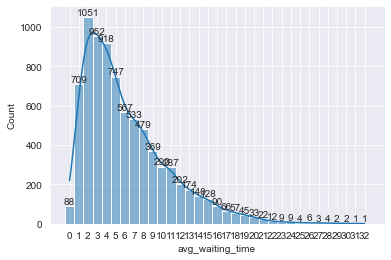

In [8]:

ax = sns.histplot(rounded_numbers_avg_waiting_time, kde=True, bins=17, discrete=True)

plt.xticks(range(min(rounded_numbers_avg_waiting_time), max(rounded_numbers_avg_waiting_time) + 1))

for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2, p.get_height(),
            '{:.0f}'.format(p.get_height()), ha='center', va='bottom')
plt.xlabel('avg_waiting_time')
plt.show()

# prob_wait

In [9]:
prob_wait

[0.6,
 0.8,
 0.4666666666666667,
 0.8666666666666667,
 0.6,
 0.7333333333333333,
 0.3333333333333333,
 0.8666666666666667,
 0.9333333333333333,
 0.7333333333333333,
 0.6666666666666666,
 0.9333333333333333,
 0.8666666666666667,
 0.9333333333333333,
 0.7333333333333333,
 0.4666666666666667,
 0.3333333333333333,
 0.6666666666666666,
 0.8,
 0.6666666666666666,
 0.26666666666666666,
 0.5333333333333333,
 0.5333333333333333,
 0.7333333333333333,
 0.5333333333333333,
 0.9333333333333333,
 0.8,
 0.8666666666666667,
 0.7333333333333333,
 0.7333333333333333,
 0.8666666666666667,
 0.9333333333333333,
 0.6,
 0.9333333333333333,
 0.6666666666666666,
 0.6,
 0.7333333333333333,
 0.5333333333333333,
 0.4666666666666667,
 0.4666666666666667,
 0.3333333333333333,
 0.6,
 0.5333333333333333,
 0.6,
 0.7333333333333333,
 0.6666666666666666,
 0.6,
 0.6,
 0.8,
 0.8,
 0.6666666666666666,
 0.3333333333333333,
 0.26666666666666666,
 0.6,
 0.9333333333333333,
 0.4,
 0.8666666666666667,
 0.8,
 0.8666666666666667,

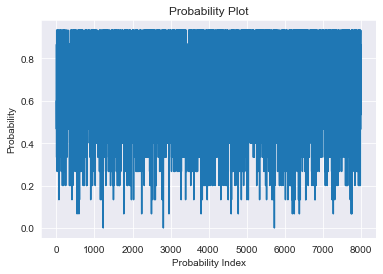

In [10]:
sns.lineplot(x=range(len(prob_wait)), y=prob_wait)
plt.xlabel('Probability Index')
plt.ylabel('Probability')
plt.title('Probability Plot')
plt.show()

In [11]:
average_probability_time=np.mean(prob_wait)
print('average_probability_wait_time  ---> ',average_probability_time )

average_probability_wait_time  --->  0.6852166666666667


# probability of ideal time


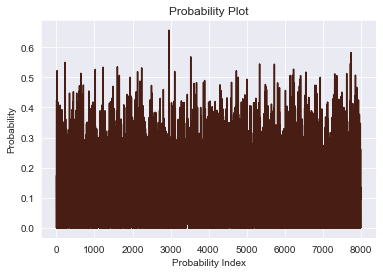

In [12]:
sns.lineplot(x=range(len(prob_idle)), y=prob_idle,color='#481E14')
plt.xlabel('Probability Index')
plt.ylabel('Probability')
plt.title('Probability Plot')
plt.show()

# average_service_time 


In [13]:
for i in range(len(N_C)):
    avg_service_time.append(total_service_time[i]/N_C[i])
len(avg_service_time)

8000

In [14]:
rounded_numbers_avg_service_time = [round(num) for num in avg_service_time]
max(rounded_numbers_avg_service_time)

7

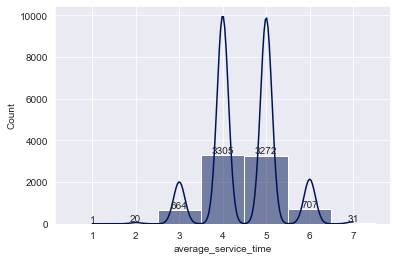

In [15]:
ax = sns.histplot(rounded_numbers_avg_service_time, kde=True, bins=17, discrete=True,color='#001253')

plt.xticks(range(min(rounded_numbers_avg_service_time), max(rounded_numbers_avg_service_time) + 1))

for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2, p.get_height(),
            '{:.0f}'.format(p.get_height()), ha='center', va='bottom')
plt.xlabel('average_service_time')
plt.show()

# arriver time between arrivals

In [16]:
for i in range(len(N_C)):
    avg_time_between_arrivals.append(total_time_between_arrivals[i]/(N_C[i]-1))
len(avg_time_between_arrivals)

8000

In [17]:
rounded_numbers_avg_time_between_arrivals = [round(num) for num in avg_time_between_arrivals]
max(rounded_numbers_avg_time_between_arrivals)

8

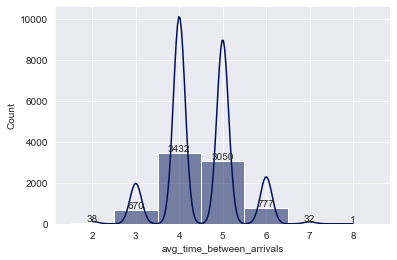

In [18]:
ax = sns.histplot(rounded_numbers_avg_time_between_arrivals, kde=True, bins=17, discrete=True,color='#001253')

plt.xticks(range(min(rounded_numbers_avg_time_between_arrivals), max(rounded_numbers_avg_time_between_arrivals) + 1))

for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2, p.get_height(),
            '{:.0f}'.format(p.get_height()), ha='center', va='bottom')
plt.xlabel('avg_time_between_arrivals')
plt.show()

# avg_waiting_time_of_who_wait

In [19]:
rounded_numbers_avg_waiting_time_of_who_wait = [round(num) for num in avg_waiting_time_of_who_wait]
max(rounded_numbers_avg_waiting_time_of_who_wait)

271

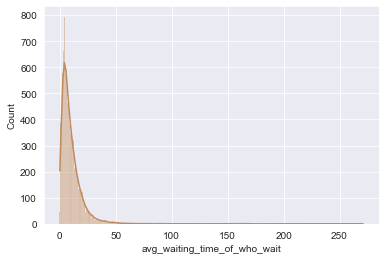

In [20]:
ax = sns.histplot(rounded_numbers_avg_waiting_time_of_who_wait, kde=True, bins=5, discrete=True,color='#C08B5C')

#--------------> if number of iteraion is كتيير then comment this below code 
# for p in ax.patches:
#     ax.text(p.get_x() + p.get_width() / 2, p.get_height(),
#             '{:.0f}'.format(p.get_height()), ha='center', va='bottom')

plt.xlabel('avg_waiting_time_of_who_wait')
plt.show()

# avg_customer_spend_ in_systeam

In [21]:
rounded_numbers_avg_customer_spend_systeam = [round(num) for num in avg_customer_spend_systeam]
max(rounded_numbers_avg_customer_spend_systeam)

38

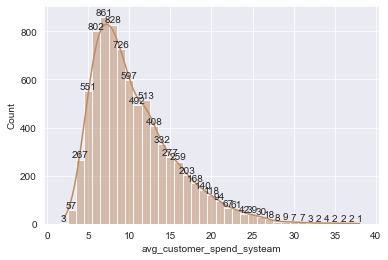

In [22]:
ax = sns.histplot(rounded_numbers_avg_customer_spend_systeam, kde=True, bins=5, discrete=True,color='#BE8C63')


for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2, p.get_height(),
            '{:.0f}'.format(p.get_height()), ha='center', va='bottom')
plt.xlabel('avg_customer_spend_systeam')
plt.show()